In [1]:
#Import necessary libraries
import pandas as pd
import geopandas as gp 
import numpy as np 
from pandas import read_csv
import requests
import os
from math import sqrt

# Documentation and Loading Files

North Carolina
--------------
Election results and precinct shapefile from the State Board of Elections (https://dl.ncsbe.gov/)

The following counties had curbside, provisional, or miscellaneous early votes reported at the county level: Bertie, Catawba, Durham, Halifax, Jackson, Lenoir, Martin, Mecklenburg, Pitt, Robeson, Stokes, and Surry. These were distributed to precincts based on the precinct's share of the county vote for each candidate.

The following precincts reported combined results. These were distributed based on voter registration shares as of Election Day (also from the NCSBE).

Buncombe: 05.1/56.2/68.1
Columbus: P20A/P22A
Craven 17/19
Cumberland: CC17/CC31
Edgecombe: 0101/0104
Forsyth: 402/403
Gaston: 39/43
Granville: BERE/CORI/WOEL
Mecklenburg: 013/014, 016/141, 063/064, 115/116, 150/151, 225/226
New Hanover: W03/W21
Robeson: 03/11A/15/38
Scotland: 09/10
Wake: 01-23/01-25
Washington: LM/P3
Wilson: PRTA/PRTO

In cases with combined precincts and countywide vote pools, the precinct votes were distributed first, then the countywide votes.

G16PRERTRU - Donald Trump (Republican Party)
G16PREDCLI - Hillary Clinton (Democratic Party)
G16PRELJOH - Gary Johnson (Libertarian Party)
G16PREOWRI - Write-in Votes

G16USSRBUR - Richard Burr (Republican Party)
G16USSDROS - Deborah Ross (Democratic Party)
G16USSLHAU - Sean Haugh (Libertarian Party)

G16GOVRMCC - Pat McCrory (Republican Party)
G16GOVDCOO - Roy Cooper (Democratic Party)
G16GOVLCEC - Lon Cecil (Libertarian Party)

G16LTGRFOR - Dan Forest (Republican Party)
G16LTGDCOL - Linda Coleman (Democratic Party)
G16LTGLCOL - Jacki Cole (Libertarian Party)

G16ATGRNEW - Buck Newton (Republican Party)
G16ATGDSTE - Josh Stein (Democratic Party)

G16TRERFOL - Dale R. Folwell (Republican Party)
G16TREDBLU - Dan Blue III (Democratic Party)

G16SOSRLAP - Michael LaPaglia (Republican Party)
G16SOSDMAR - Elaine Marshall (Democratic Party)

G16AUDRSTU - Chuck Stuber (Republican Party)
G16AUDDWOO - Beth A. Wood (Democratic Party)

G16AGRRTRO - Steve Troxler (Republican Party)
G16AGRDSMI - Walter Smith (Democratic Party)

G16INSRCAU - Mike Causey (Republican Party)
G16INSDGOO - Wayne Goodwin (Democratic Party)

G16LABRBER - Cherie Berry (Republican Party)
G16LABDMEE - Charles Meeker (Democratic Party)
G16LABOWRI - Write-in Votes

G16SPIRJOH - Mark Johnson (Republican Party)
G16SPIDATK - June Atkinson (Democratic Party)

G16SSCREDM - Robert H. Edmunds (Non-partisan but Republican-aligned)
G16SSCDMOR - Michael R. Mogran (Non-partisan but Democrat-aligned)

G16SACRDIE - Richard Dietz (Republican Party)
G16SACDROZ - Vince Rozier (Democratic Party)

G16SACRMUR - Hunter Murphy (Republican Party)
G16SACDEAG - Margaret Eagles (Democratic Party)
G16SACUBUI - Donald Ray Blue (Unaffiliated)

G16SACRHUN - Bob Hunter (Republican Party)
G16SACDJON - Abe Jones (Democratic Party)

G16SACRBER - Phil Berger, Jr. (Republican Party)
G16SACDSTE - Linda Stephens (Democratic Party)

G16SACRZAC - Valerie Zachary (Republican Party)
G16SACDMCK - Rickye McKoy-Mitchell (Democratic Party)



In [2]:
#Read in all of the necessary files

#VEST file
final = gp.read_file('./VEST/nc_2016.shp')
#Precinct geography shapefile
precincts = gp.read_file('./raw-data/SBE_PRECINCTS_20161004/Precincts.shp')
#Election results dataset
elec = pd.read_csv('./raw-data/results_sort_20161108/results_sort_20161108.txt', sep='\t', lineterminator='\r')
#Voter registration dataset
voter_reg = pd.read_csv('./raw-data/voter_stats_20161108/voter_stats_20161108.txt',sep='\t',lineterminator='\r')

#Set options for pandas displays
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# Clean the Election Dataset

In [3]:
#Create a list of candidates from the VEST documentation

# List of candidates names from VEST documentation
cand_vest = ['Donald Trump','Hillary Clinton','Gary Johnson','Richard Burr','Deborah Ross','Sean Haugh','Pat McCrory',
        'Roy Cooper','Lon Cecil','Dan Forest','Linda Coleman','Jacki Cole','Buck Newton','Josh Stein','Dale R. Folwell',
        'Dan Blue III','Michael LaPaglia','Elaine Marshall','Chuck Stuber','Beth A. Wood','Steve Troxler','Walter Smith',
        'Mike Causey','Wayne Goodwin','Cherie Berry','Charles Meeker','Mark Johnson','June Atkinson','Robert H. Edmunds',
        'Michael R. Mogran','Richard Dietz','Vince Rozier','Hunter Murphy','Margaret Eagles','Donald Ray Blue','Bob Hunter',
        'Abe Jones','Phil Berger, Jr.','Linda Stephens','Valerie Zachary','Rickye McKoy-Mitchell']
cand_vest = sorted(cand_vest)

In [4]:
#List of all candidates in election dataset

choices = sorted(list(elec['candidate_name'].unique().astype(str)))

In [5]:
#See which candidates are named the same in both lists

in_both = []
for i in choices:
    if i in cand_vest:
        in_both.append(i)
    else:
        continue

#See which candidates are in the VEST file but not named the same in the elections dataset
vest_only = []
for i in cand_vest:
    if i not in in_both:
        print(i, ' is not named the same in the election results.')
        vest_only.append(i)

Deborah Ross  is not named the same in the election results.
Donald Ray Blue  is not named the same in the election results.
Donald Trump  is not named the same in the election results.
Michael R. Mogran  is not named the same in the election results.
Robert H. Edmunds  is not named the same in the election results.


In [6]:
#Subset the full list of candidates by the last names in the VEST only list, to see if we can modify any to match

vest_only_last_name = []
for i in vest_only:
    last = i.split(' ')[-1]
    vest_only_last_name.append(last)

potential_names = []
for i in choices:
    for j in vest_only_last_name:
        if j in i:
            potential_names.append(i)
print(potential_names)

['Dan Blue', 'Dan Blue III', 'Deborah K. Ross', 'Donald J. Trump', 'Lisa Blue Thacker', 'Robert H. (Bob) Edmunds', 'Ron Ross', 'Ross Munro', 'Ross Streater', 'Stephen Ross']


In [7]:
#From looking at the extractions and what is missing, determine how to modify the cand_list

cand_list = []
for i in cand_vest:
    if i == 'Deborah Ross':
        i = 'Deborah K. Ross'
    elif i == 'Donald Trump':
        i = 'Donald J. Trump'
    elif i == 'Robert H. Edmunds':
        i = 'Robert H. (Bob) Edmunds'
    cand_list.append(i)

In [8]:
#Repeat the previous process again

#See which candidates are named the same in both
in_both = []
for i in choices:
    if i in cand_list:
        in_both.append(i)
    else:
        continue

#See which candidates are in the VEST file but not named the same in the elections dataset
cand_list_only = []
for i in cand_list:
    if i not in in_both:
        print(i, ' is not named the same in the election results (or modified).')
        cand_list_only.append(i)

Donald Ray Blue  is not named the same in the election results (or modified).
Michael R. Mogran  is not named the same in the election results (or modified).


In [9]:
# Since we couldn't idenitfy these based on a last name match, we will try a fisrt name match.

#Subset the full list of candidates by the first names in the cand only list, to see if we can modify any to match
cand_only_first = []
for i in cand_list_only:
    first = i.split(' ')[0]
    cand_only_first.append(first)

potential_names = []
for i in choices:
    for j in cand_only_first:
        if j in i:
            potential_names.append(i)
print(potential_names)

['David Michael Spruill', 'Donald Agee', 'Donald Chapman', 'Donald J. Trump', 'Donald Long', 'Donald M. Faircloth, Jr.', 'Donald Ray Buie', 'G. Michael Cogdell', 'Michael (Mike) Boose', 'Michael (Mike) Stone', 'Michael A. Paul', 'Michael Absher', 'Michael Bell', 'Michael Booth', 'Michael C. Surles', 'Michael Denning', 'Michael Garrett', 'Michael H. Wray', 'Michael Hylton', 'Michael J. Underwood', 'Michael Julian', 'Michael LaPaglia', 'Michael Lee', 'Michael Marion', 'Michael R. (Mike) Morgan', 'Michael Schriver', 'Michael Shelton', 'Michael Shepherd', 'Michael Speciale', 'Michael T. Lentz', 'Michael Tanbusch', 'Michael Tyler', 'Michael Van Sickle', 'Michael W. Holleman', 'Michael Wilder', 'R. Michael Jordan']


In [10]:
#Based on the print out from above, make the changes to the list

cand_list2 = []
for i in cand_list:
    if i == 'Donald Ray Blue':
        i = 'Donald Ray Buie'
    elif i == 'Michael R. Mogran':
        i = 'Michael R. (Mike) Morgan'
    cand_list2.append(i)

In [11]:
#Check to confirm that the list matches up correctly

#See which candidates are named the same in both
in_both = []
for i in choices:
    if i in cand_list2:
        in_both.append(i)
    else:
        continue

#See which candidates are in the VEST file but not named the same in the elections dataset

cand_list_only = []
for i in cand_list2:
    if i not in in_both:
        print(i, ' is not named the same in the election results (or modified).')
        cand_list_only.append(i)
if len(cand_list_only) == 0:
    print('All of the candidates have been identified in the election results.')

All of the candidates have been identified in the election results.


In [12]:
# Based on VEST documentation, the are write-in candidates for President and the Commissioner of Labor

# Print out possible contest names
opts = ['PRESIDENT','LABOR']
contests_write_in = []
for i in elec['contest_name']:
    for j in opts:
        if j in i:
            contests_write_in.append (i)
contests_write_in = set(contests_write_in)
print(contests_write_in)

{'NC COMMISSIONER OF LABOR', 'US PRESIDENT'}


In [13]:
#Create a list of races for write-ins
write_in_contests = ['US PRESIDENT','NC COMMISSIONER OF LABOR']

#Subset the data by the candidates and the write-in races
elec = elec[elec['candidate_name'].isin(in_both) | elec['contest_name'].isin(write_in_contests)]
elec.head()

,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
24,1,ALAMANCE,01,PATTERSON,NC ATTORNEY GENERAL,1.0,Buck Newton,1784
25,1,ALAMANCE,01,PATTERSON,NC ATTORNEY GENERAL,1.0,Josh Stein,519
28,1,ALAMANCE,01,PATTERSON,NC AUDITOR,1.0,Beth A. Wood,534
29,1,ALAMANCE,01,PATTERSON,NC AUDITOR,1.0,Chuck Stuber,1748
33,1,ALAMANCE,01,PATTERSON,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,1935


In [14]:
#Examine precinct shapefile to make a unique ID

print(precincts.columns)
precincts.head()

Index(['PREC_ID', 'ENR_DESC', 'COUNTY_NAM', 'OF_PREC_ID', 'COUNTY_ID',
       'geometry'],
      dtype='object')


,PREC_ID,ENR_DESC,COUNTY_NAM,OF_PREC_ID,COUNTY_ID,geometry
0,06N,06N_NORTH GRAHAM,ALAMANCE,None,1,"POLYGON ((1884558.650 851226.326, 1885054.111 ..."
1,1210,1210_BURLINGTON 10,ALAMANCE,None,1,"POLYGON ((1867094.976 842884.069, 1865175.888 ..."
2,06E,06E_EAST GRAHAM,ALAMANCE,None,1,"POLYGON ((1885497.824 846796.676, 1885553.601 ..."
3,063,063_GRAHAM 3,ALAMANCE,None,1,"POLYGON ((1885054.111 851287.359, 1884558.650 ..."
4,12N,12N_NORTH BURLINGTON,ALAMANCE,None,1,"POLYGON ((1872167.539 854095.379, 1872149.748 ..."


In [15]:
print('Number of unique precincts in precincts shapefile: ', precincts.shape[0])
precincts['PRECINCTS'] = precincts.apply(lambda x: '_'.join([x['COUNTY_NAM'],x['PREC_ID']]),axis=1)
print('Number of unique IDs created: ', precincts['PRECINCTS'].nunique())
matching = precincts.shape[0]== precincts['PRECINCTS'].nunique()
print('Is there a unique ID for each precinct in the dataset? (T/F)', str(matching))

Number of unique precincts in precincts shapefile:  2704
Number of unique IDs created:  2704
Is there a unique ID for each precinct in the dataset? (T/F) True


In [16]:
#Examine VEST file to create a unique ID (same as precinct shapefile)

print(final.columns)
final.head()

Index(['PREC_ID', 'ENR_DESC', 'COUNTY_NAM', 'OF_PREC_ID', 'COUNTY_ID',
       'G16PRERTRU', 'G16PREDCLI', 'G16PRELJOH', 'G16PREOWRI', 'G16USSRBUR',
       'G16USSDROS', 'G16USSLHAU', 'G16GOVRMCC', 'G16GOVDCOO', 'G16GOVLCEC',
       'G16LTGRFOR', 'G16LTGDCOL', 'G16LTGLCOL', 'G16ATGRNEW', 'G16ATGDSTE',
       'G16TRERFOL', 'G16TREDBLU', 'G16SOSRLAP', 'G16SOSDMAR', 'G16AUDRSTU',
       'G16AUDDWOO', 'G16AGRRTRO', 'G16AGRDSMI', 'G16INSRCAU', 'G16INSDGOO',
       'G16LABRBER', 'G16LABDMEE', 'G16LABOWRI', 'G16SPIRJOH', 'G16SPIDATK',
       'G16SSCREDM', 'G16SSCDMOR', 'G16SACRDIE', 'G16SACDROZ', 'G16SACRMUR',
       'G16SACDEAG', 'G16SACUBUI', 'G16SACRHUN', 'G16SACDJON', 'G16SACRBER',
       'G16SACDSTE', 'G16SACRZAC', 'G16SACDMCK', 'geometry'],
      dtype='object')


,PREC_ID,ENR_DESC,COUNTY_NAM,OF_PREC_ID,COUNTY_ID,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,geometry
0,06N,06N_NORTH GRAHAM,ALAMANCE,None,1,423,834,38,10,420,821,39,409,853,22,426,804,35,400,857,418,826,380,872,401,841,460,793,417,830,467,785,0,426,819,368,699,420,813,384,797,54,436,795,404,838,421,813,"POLYGON ((1884558.650 851226.326, 1885054.111 ..."
1,1210,1210_BURLINGTON 10,ALAMANCE,None,1,569,607,33,21,587,596,35,545,659,19,583,588,33,553,643,582,604,521,666,550,635,628,562,565,619,639,554,0,566,626,445,598,584,577,527,570,62,590,575,548,617,580,577,"POLYGON ((1867094.976 842884.069, 1865175.888 ..."
2,06E,06E_EAST GRAHAM,ALAMANCE,None,1,671,741,39,14,680,728,38,651,780,23,674,706,43,646,779,654,748,592,817,617,783,735,689,649,764,761,658,1,634,776,518,688,679,704,605,702,77,673,718,626,769,669,710,"POLYGON ((1885497.824 846796.676, 1885553.601 ..."
3,063,063_GRAHAM 3,ALAMANCE,None,1,528,996,29,8,530,964,57,549,980,25,550,937,42,530,994,525,989,484,1030,509,999,586,939,525,983,611,905,3,545,965,499,820,530,954,490,901,95,546,939,516,985,553,943,"POLYGON ((1885054.111 851287.359, 1884558.650 ..."
4,12N,12N_NORTH BURLINGTON,ALAMANCE,None,1,289,1777,45,7,294,1721,78,302,1746,45,290,1719,58,289,1775,302,1748,267,1796,274,1772,335,1728,286,1768,351,1697,2,303,1747,453,1298,300,1732,262,1709,68,310,1726,275,1777,303,1736,"POLYGON ((1872167.539 854095.379, 1872149.748 ..."


In [17]:
print('Number of unique precincts in VEST file: ', final.shape[0])
final['PRECINCTS'] = final.apply(lambda x: '_'.join([x['COUNTY_NAM'],x['PREC_ID']]),axis=1)
print('Number of unique IDs created: ', final['PRECINCTS'].nunique())
matching = final.shape[0]== final['PRECINCTS'].nunique()
print('Is there a unique ID for each precinct in the dataset? (T/F)', str(matching))

Number of unique precincts in VEST file:  2704
Number of unique IDs created:  2704
Is there a unique ID for each precinct in the dataset? (T/F) True


In [18]:
# There are a number of split precincts that VEST notes. 
# Check out how those precincts are written.
print('BUNCOMBE')
buncombe = elec[elec['county_desc']=='BUNCOMBE'].copy()
display(buncombe)
columbus = elec[elec['county_desc']=='COLUMBUS'].copy()
display(columbus)
craven = elec[elec['county_desc']=='CRAVEN'].copy()
display(craven)
cumberland = elec[elec['county_desc']=='CUMBERLAND'].copy()
display(cumberland)
edgecombe = elec[elec['county_desc']=='EDGECOMBE'].copy()
display(edgecombe)
forsyth = elec[elec['county_desc']=='FORSYTH'].copy()
display(forsyth)
gaston = elec[elec['county_desc']=='GASTON'].copy()
display(gaston)
granville = elec[elec['county_desc']=='GRANVILLE'].copy()
display(granville)
mecklenburg =elec[elec['county_desc']=='MECKLENBURG'].copy()
display(mecklenburg)
new_hanover = elec[elec['county_desc']=='NEW HANOVER'].copy()
display(new_hanover)
robeson = elec[elec['county_desc']=='ROBESON'].copy()
display(robeson)
scotland = elec[elec['county_desc']=='SCOTLAND'].copy()
display(scotland)
wake = elec[elec['county_desc']=='WAKE'].copy()
display(wake)
washington = elec[elec['county_desc']=='WASHINGTON'].copy()
display(washington)
wilson = elec[elec['county_desc']=='WILSON'].copy()
display(wilson)


BUNCOMBE


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
22429,11,BUNCOMBE,01.1,01.1,NC ATTORNEY GENERAL,1.0,Buck Newton,207
22430,11,BUNCOMBE,01.1,01.1,NC ATTORNEY GENERAL,1.0,Josh Stein,1236
22433,11,BUNCOMBE,01.1,01.1,NC AUDITOR,1.0,Beth A. Wood,1218
22434,11,BUNCOMBE,01.1,01.1,NC AUDITOR,1.0,Chuck Stuber,211
22438,11,BUNCOMBE,01.1,01.1,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,223
22440,11,BUNCOMBE,01.1,01.1,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,1206
22441,11,BUNCOMBE,01.1,01.1,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,204
22444,11,BUNCOMBE,01.1,01.1,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,1219
22445,11,BUNCOMBE,01.1,01.1,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,1159
22446,11,BUNCOMBE,01.1,01.1,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,263


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
64034,24,COLUMBUS,P01A,BOGUE,NC ATTORNEY GENERAL,1.0,Buck Newton,513
64035,24,COLUMBUS,P01A,BOGUE,NC ATTORNEY GENERAL,1.0,Josh Stein,530
64038,24,COLUMBUS,P01A,BOGUE,NC AUDITOR,1.0,Beth A. Wood,516
64039,24,COLUMBUS,P01A,BOGUE,NC AUDITOR,1.0,Chuck Stuber,502
64043,24,COLUMBUS,P01A,BOGUE,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,543
64045,24,COLUMBUS,P01A,BOGUE,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,494
64046,24,COLUMBUS,P01A,BOGUE,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,526
64049,24,COLUMBUS,P01A,BOGUE,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,500
64050,24,COLUMBUS,P01A,BOGUE,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,474
64051,24,COLUMBUS,P01A,BOGUE,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,551


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
67363,25,CRAVEN,02,HAVELOCK,NC ATTORNEY GENERAL,1.0,Buck Newton,3258
67364,25,CRAVEN,02,HAVELOCK,NC ATTORNEY GENERAL,1.0,Josh Stein,1956
67367,25,CRAVEN,02,HAVELOCK,NC AUDITOR,1.0,Beth A. Wood,1999
67368,25,CRAVEN,02,HAVELOCK,NC AUDITOR,1.0,Chuck Stuber,3114
67372,25,CRAVEN,02,HAVELOCK,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,3247
67374,25,CRAVEN,02,HAVELOCK,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,1896
67375,25,CRAVEN,02,HAVELOCK,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,3200
67378,25,CRAVEN,02,HAVELOCK,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,1924
67379,25,CRAVEN,02,HAVELOCK,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,1783
67380,25,CRAVEN,02,HAVELOCK,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,3339


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
71002,26,CUMBERLAND,AH49,ARRAN HILLS,NC ATTORNEY GENERAL,1.0,Buck Newton,595
71003,26,CUMBERLAND,AH49,ARRAN HILLS,NC ATTORNEY GENERAL,1.0,Josh Stein,1504
71006,26,CUMBERLAND,AH49,ARRAN HILLS,NC AUDITOR,1.0,Beth A. Wood,1533
71007,26,CUMBERLAND,AH49,ARRAN HILLS,NC AUDITOR,1.0,Chuck Stuber,554
71011,26,CUMBERLAND,AH49,ARRAN HILLS,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,612
71013,26,CUMBERLAND,AH49,ARRAN HILLS,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,1470
71014,26,CUMBERLAND,AH49,ARRAN HILLS,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,564
71017,26,CUMBERLAND,AH49,ARRAN HILLS,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,1516
71018,26,CUMBERLAND,AH49,ARRAN HILLS,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,1450
71019,26,CUMBERLAND,AH49,ARRAN HILLS,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,635


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
101932,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC ATTORNEY GENERAL,1.0,Buck Newton,744
101933,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC ATTORNEY GENERAL,1.0,Josh Stein,2343
101936,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC AUDITOR,1.0,Beth A. Wood,2407
101937,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC AUDITOR,1.0,Chuck Stuber,657
101941,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,837
101943,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,2237
101944,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,690
101947,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,2388
101948,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,2270
101949,33,EDGECOMBE,0101;0104,TARBORO 1 AND TARBORO 4,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,807


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
104355,34,FORSYTH,011,011,NC ATTORNEY GENERAL,1.0,Buck Newton,1980
104356,34,FORSYTH,011,011,NC ATTORNEY GENERAL,1.0,Josh Stein,1466
104359,34,FORSYTH,011,011,NC AUDITOR,1.0,Beth A. Wood,1432
104360,34,FORSYTH,011,011,NC AUDITOR,1.0,Chuck Stuber,1967
104364,34,FORSYTH,011,011,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,2193
104366,34,FORSYTH,011,011,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,1233
104367,34,FORSYTH,011,011,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,1979
104370,34,FORSYTH,011,011,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,1403
104371,34,FORSYTH,011,011,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,1160
104372,34,FORSYTH,011,011,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,2264


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
122002,36,GASTON,01,YORK CHESTER,NC ATTORNEY GENERAL,1.0,Buck Newton,367
122003,36,GASTON,01,YORK CHESTER,NC ATTORNEY GENERAL,1.0,Josh Stein,454
122006,36,GASTON,01,YORK CHESTER,NC AUDITOR,1.0,Beth A. Wood,447
122007,36,GASTON,01,YORK CHESTER,NC AUDITOR,1.0,Chuck Stuber,360
122011,36,GASTON,01,YORK CHESTER,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,401
122013,36,GASTON,01,YORK CHESTER,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,405
122014,36,GASTON,01,YORK CHESTER,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,365
122017,36,GASTON,01,YORK CHESTER,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,447
122018,36,GASTON,01,YORK CHESTER,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,371
122019,36,GASTON,01,YORK CHESTER,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,446


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
129913,39,GRANVILLE,ANTI,ANTIOCH,NC ATTORNEY GENERAL,1.0,Buck Newton,243
129914,39,GRANVILLE,ANTI,ANTIOCH,NC ATTORNEY GENERAL,1.0,Josh Stein,608
129917,39,GRANVILLE,ANTI,ANTIOCH,NC AUDITOR,1.0,Beth A. Wood,634
129918,39,GRANVILLE,ANTI,ANTIOCH,NC AUDITOR,1.0,Chuck Stuber,211
129922,39,GRANVILLE,ANTI,ANTIOCH,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,288
129924,39,GRANVILLE,ANTI,ANTIOCH,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,564
129925,39,GRANVILLE,ANTI,ANTIOCH,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,225
129928,39,GRANVILLE,ANTI,ANTIOCH,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,622
129929,39,GRANVILLE,ANTI,ANTIOCH,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,589
129930,39,GRANVILLE,ANTI,ANTIOCH,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,260


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
204734,60,MECKLENBURG,001,PCT 001,NC ATTORNEY GENERAL,1.0,Buck Newton,553
204735,60,MECKLENBURG,001,PCT 001,NC ATTORNEY GENERAL,1.0,Josh Stein,650
204738,60,MECKLENBURG,001,PCT 001,NC AUDITOR,1.0,Beth A. Wood,578
204739,60,MECKLENBURG,001,PCT 001,NC AUDITOR,1.0,Chuck Stuber,592
204743,60,MECKLENBURG,001,PCT 001,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,730
204745,60,MECKLENBURG,001,PCT 001,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,430
204746,60,MECKLENBURG,001,PCT 001,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,589
204749,60,MECKLENBURG,001,PCT 001,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,565
204750,60,MECKLENBURG,001,PCT 001,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,527
204751,60,MECKLENBURG,001,PCT 001,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,651


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
247784,65,NEW HANOVER,CF01,CF01,NC ATTORNEY GENERAL,1.0,Buck Newton,1160
247785,65,NEW HANOVER,CF01,CF01,NC ATTORNEY GENERAL,1.0,Josh Stein,1263
247788,65,NEW HANOVER,CF01,CF01,NC AUDITOR,1.0,Beth A. Wood,1228
247789,65,NEW HANOVER,CF01,CF01,NC AUDITOR,1.0,Chuck Stuber,1165
247793,65,NEW HANOVER,CF01,CF01,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,1263
247795,65,NEW HANOVER,CF01,CF01,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,1133
247796,65,NEW HANOVER,CF01,CF01,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,1228
247799,65,NEW HANOVER,CF01,CF01,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,1181
247800,65,NEW HANOVER,CF01,CF01,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,1101
247801,65,NEW HANOVER,CF01,CF01,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,1305


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
282926,78,ROBESON,01,ALFORDSVILLE,NC ATTORNEY GENERAL,1.0,Buck Newton,248
282927,78,ROBESON,01,ALFORDSVILLE,NC ATTORNEY GENERAL,1.0,Josh Stein,252
282930,78,ROBESON,01,ALFORDSVILLE,NC AUDITOR,1.0,Beth A. Wood,259
282931,78,ROBESON,01,ALFORDSVILLE,NC AUDITOR,1.0,Chuck Stuber,234
282935,78,ROBESON,01,ALFORDSVILLE,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,223
282937,78,ROBESON,01,ALFORDSVILLE,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,267
282938,78,ROBESON,01,ALFORDSVILLE,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,229
282941,78,ROBESON,01,ALFORDSVILLE,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,264
282942,78,ROBESON,01,ALFORDSVILLE,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,231
282943,78,ROBESON,01,ALFORDSVILLE,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,269


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
298999,83,SCOTLAND,01,01,NC ATTORNEY GENERAL,1.0,Buck Newton,229
299000,83,SCOTLAND,01,01,NC ATTORNEY GENERAL,1.0,Josh Stein,1338
299003,83,SCOTLAND,01,01,NC AUDITOR,1.0,Beth A. Wood,1353
299004,83,SCOTLAND,01,01,NC AUDITOR,1.0,Chuck Stuber,207
299008,83,SCOTLAND,01,01,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,263
299010,83,SCOTLAND,01,01,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,1301
299011,83,SCOTLAND,01,01,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,199
299014,83,SCOTLAND,01,01,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,1373
299015,83,SCOTLAND,01,01,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,1294
299016,83,SCOTLAND,01,01,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,274


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
321660,92,WAKE,01-01,PRECINCT 01-01,NC ATTORNEY GENERAL,1.0,Buck Newton,406
321661,92,WAKE,01-01,PRECINCT 01-01,NC ATTORNEY GENERAL,1.0,Josh Stein,1240
321664,92,WAKE,01-01,PRECINCT 01-01,NC AUDITOR,1.0,Beth A. Wood,1131
321665,92,WAKE,01-01,PRECINCT 01-01,NC AUDITOR,1.0,Chuck Stuber,471
321669,92,WAKE,01-01,PRECINCT 01-01,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,591
321671,92,WAKE,01-01,PRECINCT 01-01,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,1034
321672,92,WAKE,01-01,PRECINCT 01-01,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,435
321675,92,WAKE,01-01,PRECINCT 01-01,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,1163
321676,92,WAKE,01-01,PRECINCT 01-01,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,1143
321677,92,WAKE,01-01,PRECINCT 01-01,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,492


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
355438,94,WASHINGTON,P1,PLYMOUTH 1,NC ATTORNEY GENERAL,1.0,Buck Newton,253
355439,94,WASHINGTON,P1,PLYMOUTH 1,NC ATTORNEY GENERAL,1.0,Josh Stein,658
355442,94,WASHINGTON,P1,PLYMOUTH 1,NC AUDITOR,1.0,Beth A. Wood,665
355443,94,WASHINGTON,P1,PLYMOUTH 1,NC AUDITOR,1.0,Chuck Stuber,230
355447,94,WASHINGTON,P1,PLYMOUTH 1,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,266
355449,94,WASHINGTON,P1,PLYMOUTH 1,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,645
355450,94,WASHINGTON,P1,PLYMOUTH 1,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,233
355453,94,WASHINGTON,P1,PLYMOUTH 1,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,670
355454,94,WASHINGTON,P1,PLYMOUTH 1,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,642
355455,94,WASHINGTON,P1,PLYMOUTH 1,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,258


,county_id,county_desc,precinct_code,precinct_desc,contest_name,vote_for,candidate_name,votes
366171,98,WILSON,PRBL,BLACK CREEK,NC ATTORNEY GENERAL,1.0,Buck Newton,1308
366172,98,WILSON,PRBL,BLACK CREEK,NC ATTORNEY GENERAL,1.0,Josh Stein,518
366175,98,WILSON,PRBL,BLACK CREEK,NC AUDITOR,1.0,Beth A. Wood,575
366176,98,WILSON,PRBL,BLACK CREEK,NC AUDITOR,1.0,Chuck Stuber,1211
366180,98,WILSON,PRBL,BLACK CREEK,NC COMMISSIONER OF AGRICULTURE,1.0,Steve Troxler,1363
366182,98,WILSON,PRBL,BLACK CREEK,NC COMMISSIONER OF AGRICULTURE,1.0,Walter Smith,445
366183,98,WILSON,PRBL,BLACK CREEK,NC COMMISSIONER OF INSURANCE,1.0,Mike Causey,1237
366186,98,WILSON,PRBL,BLACK CREEK,NC COMMISSIONER OF INSURANCE,1.0,Wayne Goodwin,547
366187,98,WILSON,PRBL,BLACK CREEK,NC COMMISSIONER OF LABOR,1.0,Charles Meeker,483
366188,98,WILSON,PRBL,BLACK CREEK,NC COMMISSIONER OF LABOR,1.0,Cherie Berry,1301


In [19]:
# After looking at the subsetted data by county, it looks like there are two typos
# 1. Mecklenburg 225;226 is correctly recorded in the precinct_desc but NOT in the precinct_code
# 2. Gaston 39;43 in the precinct_code field is recorded as 38;43 (there is a separeate 38 in precinct_code)

# We will correct these two mistakes that are noticed

def get225_226(prec_desc):
    prec_desc = prec_desc.replace('PCT','')
    prec_desc = prec_desc.replace('AND','')
    prec_desc = prec_desc.replace(' ','')
    prec_desc1 = prec_desc[:3]
    prec_desc2 = prec_desc[3:]
    prec_desc = ';'.join([prec_desc1,prec_desc2])
    return prec_desc

elec['precinct_code'] = elec.apply(lambda x: get225_226(x['precinct_desc']) if (x['county_desc']=='MECKLENBURG' and x['precinct_code']=='115;116') else x['precinct_code'],axis =1 )
elec['precinct_code'] = elec.apply(lambda x: x['precinct_code'].replace('38','39') if (x['county_desc']=='GASTON' and x['precinct_code']=='38;43') else x['precinct_code'],axis=1)

In [20]:
# Create a combined contest_candidate field to process write-ins correctly

#Set each field as a string
elec['county_desc'] = elec['county_desc'].astype(str)
elec['precinct_code'] = elec['precinct_code'].astype(str)

#Because we want to know which race the write-in votes are associated with, we need to keep the race in the field for the pivot
elec['choice_race'] = elec['contest_name'] + ' ' + elec['candidate_name']

In [21]:
#Create the unique ID as we do for the other fields
elec[('PRECINCTS','PRECINCTS')] = elec.apply(lambda x: '_'.join([x['county_desc'],x['precinct_code']]),axis=1)

#Rename the fields as tuples so they will match for the pivot
elec[('County','County')] = elec['county_desc']
elec[('Precinct','Precinct')] = elec['precinct_desc']

In [22]:
#Pivot the data on the unique ID
pivot = elec.pivot_table(index = [('PRECINCTS','PRECINCTS')], columns = ['choice_race'])

#Reset the index
pivot.reset_index(level=0, inplace=True)


#Fill all null data with '0' votes
pivot = pivot.fillna(0)

#Remake the County and Precinct fields
pivot[('County','County')] = pivot[('PRECINCTS','PRECINCTS')].apply(lambda x: x.split('_')[0])
pivot[('Precinct','Precinct')] = pivot[('PRECINCTS','PRECINCTS')].apply(lambda x: x.split('_')[1])

pivot.head()

PRECINCTS                       county_id  \
choice_race     PRECINCTS NC ATTORNEY GENERAL Buck Newton   
0             ALAMANCE_01                             1.0   
1             ALAMANCE_02                             1.0   
2            ALAMANCE_035                             1.0   
3            ALAMANCE_03C                             1.0   
4            ALAMANCE_03N                             1.0   

                                                                    \
choice_race NC ATTORNEY GENERAL Josh Stein NC AUDITOR Beth A. Wood   
0                                      1.0                     1.0   
1                                      1.0                     1.0   
2                                      1.0                     1.0   
3                                      1.0                     1.0   
4                                      1.0                     1.0   

                                     \
choice_race NC AUDITOR Chuck Stuber   
0                               1.0   
1                               1.0   
2                               1.0   
3                               1.0   
4                               1.0   

                                                          \
choice_race NC COMMISSIONER OF AGRICULTURE Steve Troxler   
0                                                    1.0   
1                                                    1.0   
2                                                    1.0   
3                                                    1.0   
4                                                    1.0   

                                                         \
choice_race NC COMMISSIONER OF AGRICULTURE Walter Smith   
0                                                   1.0   
1                                                   1.0   
2                                                   1.0   
3                                                   1.0   
4                                                   1.0   

                                                      \
choice_race NC COMMISSIONER OF INSURANCE Mike Causey   
0                                                1.0   
1                                                1.0   
2                                                1.0   
3                                                1.0   
4                                                1.0   

                                                        \
choice_race NC COMMISSIONER OF INSURANCE Wayne Goodwin   
0                                                  1.0   
1                                                  1.0   
2                                                  1.0   
3                                                  1.0   
4                                                  1.0   

                                                     \
choice_race NC COMMISSIONER OF LABOR Charles Meeker   
0                                               1.0   
1                                               1.0   
2                                               1.0   
3                                               1.0   
4                                               1.0   

                                                   \
choice_race NC COMMISSIONER OF LABOR Cherie Berry   
0                                             1.0   
1                                             1.0   
2                                             1.0   
3                                             1.0   
4                                             1.0   

                                                 \
choice_race NC COMMISSIONER OF LABOR OVER VOTES   
0                                           1.0   
1                                           1.0   
2                                           1.0   
3                                           1.0   
4                                           1.0   

                                                  \
choice_race NC COMMI

In [23]:
# Subset the columns of the pivoted data to just be total votes

total_votes = []

for i in pivot.columns:
    if 'votes' in i: #gets just the 'votes' fields (represents total votes)
        total_votes.append(i)
        
#Add back the non-vote fields that are needed
total_votes.append(('PRECINCTS','PRECINCTS'))
total_votes.append(('County','County'))
total_votes.append(('Precinct','Precinct'))

#View that columns that will be kept
print(total_votes)

[('votes', 'NC ATTORNEY GENERAL Buck Newton'), ('votes', 'NC ATTORNEY GENERAL Josh Stein'), ('votes', 'NC AUDITOR Beth A. Wood'), ('votes', 'NC AUDITOR Chuck Stuber'), ('votes', 'NC COMMISSIONER OF AGRICULTURE Steve Troxler'), ('votes', 'NC COMMISSIONER OF AGRICULTURE Walter Smith'), ('votes', 'NC COMMISSIONER OF INSURANCE Mike Causey'), ('votes', 'NC COMMISSIONER OF INSURANCE Wayne Goodwin'), ('votes', 'NC COMMISSIONER OF LABOR Charles Meeker'), ('votes', 'NC COMMISSIONER OF LABOR Cherie Berry'), ('votes', 'NC COMMISSIONER OF LABOR OVER VOTES'), ('votes', 'NC COMMISSIONER OF LABOR UNDER VOTES'), ('votes', 'NC COMMISSIONER OF LABOR WRITE-IN'), ('votes', 'NC COURT OF APPEALS JUDGE (DIETZ) Richard Dietz'), ('votes', 'NC COURT OF APPEALS JUDGE (DIETZ) Vince Rozier'), ('votes', 'NC COURT OF APPEALS JUDGE (GEER) Donald Ray Buie'), ('votes', 'NC COURT OF APPEALS JUDGE (GEER) Hunter Murphy'), ('votes', 'NC COURT OF APPEALS JUDGE (GEER) Margaret Eagles'), ('votes', 'NC COURT OF APPEALS JUDGE (

In [24]:
# Subset the data

pivot = pivot[total_votes]
pivot.head()

votes                                 \
choice_race NC ATTORNEY GENERAL Buck Newton NC ATTORNEY GENERAL Josh Stein   
0                                    1784.0                          519.0   
1                                    1909.0                          497.0   
2                                    1442.0                         1042.0   
3                                    1094.0                          720.0   
4                                    1198.0                         1008.0   

                                                             \
choice_race NC AUDITOR Beth A. Wood NC AUDITOR Chuck Stuber   
0                             534.0                  1748.0   
1                             489.0                  1872.0   
2                            1002.0                  1451.0   
3                             682.0                  1102.0   
4                             985.0                  1186.0   

                                                          \
choice_race NC COMMISSIONER OF AGRICULTURE Steve Troxler   
0                                                 1935.0   
1                                                 2109.0   
2                                                 1685.0   
3                                                 1339.0   
4                                                 1402.0   

                                                         \
choice_race NC COMMISSIONER OF AGRICULTURE Walter Smith   
0                                                 379.0   
1                                                 298.0   
2                                                 800.0   
3                                                 471.0   
4                                                 792.0   

                                                      \
choice_race NC COMMISSIONER OF INSURANCE Mike Causey   
0                                             1795.0   
1                                             1910.0   
2                                             1490.0   
3                                             1121.0   
4                                             1206.0   

                                                        \
choice_race NC COMMISSIONER OF INSURANCE Wayne Goodwin   
0                                                487.0   
1                                                458.0   
2                                                959.0   
3                                                654.0   
4                                                946.0   

                                                     \
choice_race NC COMMISSIONER OF LABOR Charles Meeker   
0                                             392.0   
1                                             323.0   
2                                             789.0   
3                                             472.0   
4                                             763.0   

                                                   \
choice_race NC COMMISSIONER OF LABOR Cherie Berry   
0                                          1901.0   
1                                          2064.0   
2                                          1678.0   
3                                          1335.0   
4                                          1428.0   

                                                 \
choice_race NC COMMISSIONER OF LABOR OVER VOTES   
0                                           0.0   
1                                           0.0   
2                                           0.0   
3                                           0.0   
4                                           0.0   

                                                  \
choice_race NC COMMISSIONER OF LABOR UNDER VOTES   
0                                           73.0   
1                                           95.0   
2                                          126.0   
3                                     

In [25]:
# Drop the upper level of the tuple in the column names

pivot.columns = pivot.columns.droplevel(0)
pivot.head()

choice_race,NC ATTORNEY GENERAL Buck Newton,NC ATTORNEY GENERAL Josh Stein,NC AUDITOR Beth A. Wood,NC AUDITOR Chuck Stuber,NC COMMISSIONER OF AGRICULTURE Steve Troxler,NC COMMISSIONER OF AGRICULTURE Walter Smith,NC COMMISSIONER OF INSURANCE Mike Causey,NC COMMISSIONER OF INSURANCE Wayne Goodwin,NC COMMISSIONER OF LABOR Charles Meeker,NC COMMISSIONER OF LABOR Cherie Berry,NC COMMISSIONER OF LABOR OVER VOTES,NC COMMISSIONER OF LABOR UNDER VOTES,NC COMMISSIONER OF LABOR WRITE-IN,NC COURT OF APPEALS JUDGE (DIETZ) Richard Dietz,NC COURT OF APPEALS JUDGE (DIETZ) Vince Rozier,NC COURT OF APPEALS JUDGE (GEER) Donald Ray Buie,NC COURT OF APPEALS JUDGE (GEER) Hunter Murphy,NC COURT OF APPEALS JUDGE (GEER) Margaret Eagles,NC COURT OF APPEALS JUDGE (HUNTER) Abe Jones,NC COURT OF APPEALS JUDGE (HUNTER) Bob Hunter,NC COURT OF APPEALS JUDGE (STEPHENS) Linda Stephens,"NC COURT OF APPEALS JUDGE (STEPHENS) Phil Berger, Jr.",NC COURT OF APPEALS JUDGE (ZACHARY) Rickye McKoy-Mitchell,NC COURT OF APPEALS JUDGE (ZACHARY) Valerie Zachary,NC GOVERNOR Lon Cecil,NC GOVERNOR Pat McCrory,NC GOVERNOR Roy Cooper,NC LIEUTENANT GOVERNOR Dan Forest,NC LIEUTENANT GOVERNOR Jacki Cole,NC LIEUTENANT GOVERNOR Linda Coleman,NC SECRETARY OF STATE Elaine Marshall,NC SECRETARY OF STATE Michael LaPaglia,NC SUPERINTENDENT OF PUBLIC INSTRUCTION June Atkinson,NC SUPERINTENDENT OF PUBLIC INSTRUCTION Mark Johnson,NC SUPREME COURT ASSOCIATE JUSTICE Michael R. (Mike) Morgan,NC SUPREME COURT ASSOCIATE JUSTICE Robert H. (Bob) Edmunds,NC TREASURER Dale R. Folwell,NC TREASURER Dan Blue III,US PRESIDENT Donald J. Trump,US PRESIDENT Gary Johnson,US PRESIDENT Hillary Clinton,US PRESIDENT OVER VOTES,US PRESIDENT UNDER VOTES,US PRESIDENT WRITE-IN,US SENATE Deborah K. Ross,US SENATE Richard Burr,US SENATE Sean Haugh,PRECINCTS,County,Precinct
0,1784.0,519.0,534.0,1748.0,1935.0,379.0,1795.0,487.0,392.0,1901.0,0.0,73.0,1.0,1826.0,429.0,123.0,1721.0,406.0,421.0,1833.0,506.0,1756.0,432.0,1813.0,45.0,1806.0,499.0,1839.0,60.0,422.0,554.0,1718.0,487.0,1790.0,888.0,1161.0,1803.0,467.0,1865.0,50.0,411.0,0.0,16.0,25.0,418.0,1829.0,89.0,ALAMANCE_01,ALAMANCE,01
1,1909.0,497.0,489.0,1872.0,2109.0,298.0,1910.0,458.0,323.0,2064.0,0.0,95.0,1.0,1955.0,364.0,114.0,1828.0,385.0,350.0,1971.0,467.0,1876.0,372.0,1937.0,39.0,1927.0,497.0,1989.0,54.0,375.0,549.0,1820.0,450.0,1922.0,917.0,1196.0,1949.0,414.0,2004.0,40.0,403.0,0.0,12.0,24.0,396.0,1973.0,79.0,ALAMANCE_02,ALAMANCE,02
2,1442.0,1042.0,1002.0,1451.0,1685.0,800.0,1490.0,959.0,789.0,1678.0,0.0,126.0,2.0,1527.0,862.0,156.0,1408.0,832.0,848.0,1542.0,944.0,1470.0,859.0,1514.0,52.0,1446.0,1060.0,1524.0,92.0,887.0,1076.0,1382.0,960.0,1492.0,1109.0,987.0,1511.0,932.0,1485.0,77.0,995.0,0.0,11.0,27.0,926.0,1532.0,96.0,ALAMANCE_035,ALAMANCE,035
3,1094.0,720.0,682.0,1102.0,1339.0,471.0,1121.0,654.0,472.0,1335.0,0.0,49.0,2.0,1172.0,549.0,97.0,1024.0,620.0,538.0,1202.0,682.0,1089.0,554.0,1166.0,35.0,1072.0,748.0,1184.0,63.0,578.0,767.0,1025.0,661.0,1126.0,681.0,882.0,1137.0,627.0,1059.0,64.0,679.0,0.0,23.0,33.0,597.0,1194.0,57.0,ALAMANCE_03C,ALAMANCE,03C
4,1198.0,1008.0,985.0,1186.0,1402.0,792.0,1206.0,946.0,763.0,1428.0,0.0,123.0,4.0,1253.0,849.0,120.0,1130.0,870.0,832.0,1278.0,942.0,1193.0,826.0,1269.0,36.0,1146.0,1101.0,1296.0,59.0,868.0,1051.0,1124.0,967.0,1201.0,1011.0,854.0,1254.0,899.0,1160.0,66.0,1036.0,0.0,21.0,35.0,956.0,1239.0,81.0,ALAMANCE_03N,ALAMANCE,03N


In [26]:
# Rename the columns to match the VEST columns


# Create the write in columns
pivot['G16PREOWRI'] = pivot.apply(lambda x: x['US PRESIDENT WRITE-IN'],axis=1)
pivot['G16LABOWRI'] = pivot.apply(lambda x: x['NC COMMISSIONER OF LABOR WRITE-IN'],axis=1)

# Remove the write-in fields (and others associated with the races that we do not need)
pivot = pivot.drop(columns = ['US PRESIDENT WRITE-IN','NC COMMISSIONER OF LABOR WRITE-IN','NC COMMISSIONER OF LABOR OVER VOTES','NC COMMISSIONER OF LABOR UNDER VOTES','US PRESIDENT OVER VOTES','US PRESIDENT UNDER VOTES'])


rename_dictionary = {'NC COURT OF APPEALS JUDGE (HUNTER) Abe Jones':'G16SACDJON', 
                     'NC AUDITOR Beth A. Wood':'G16AUDDWOO',
                     'NC COURT OF APPEALS JUDGE (HUNTER) Bob Hunter':'G16SACRHUN',
                    'NC ATTORNEY GENERAL Buck Newton':'G16ATGRNEW',
                     'NC COMMISSIONER OF LABOR Charles Meeker':'G16LABDMEE',
                     'NC COMMISSIONER OF LABOR Cherie Berry':'G16LABRBER',
                     'NC AUDITOR Chuck Stuber':'G16AUDRSTU',
                     'NC TREASURER Dale R. Folwell':'G16TRERFOL',
                     'NC TREASURER Dan Blue III':'G16TREDBLU',
                     'NC LIEUTENANT GOVERNOR Dan Forest':'G16LTGRFOR',
                     'US SENATE Deborah K. Ross':'G16USSDROS',
                     'US PRESIDENT Donald J. Trump':'G16PRERTRU',
                     'NC SECRETARY OF STATE Elaine Marshall':'G16SOSDMAR',
                     'US PRESIDENT Gary Johnson':'G16PRELJOH',
                     'US PRESIDENT Hillary Clinton':'G16PREDCLI',
                     'NC COURT OF APPEALS JUDGE (GEER) Hunter Murphy':'G16SACRMUR', 
                     'NC LIEUTENANT GOVERNOR Jacki Cole':'G16LTGLCOL',
                     'NC ATTORNEY GENERAL Josh Stein':'G16ATGDSTE',
                     'NC SUPERINTENDENT OF PUBLIC INSTRUCTION June Atkinson':'G16SPIDATK',
                     'NC LIEUTENANT GOVERNOR Linda Coleman':'G16LTGDCOL',
                     'NC COURT OF APPEALS JUDGE (STEPHENS) Linda Stephens':'G16SACDSTE',
                     'NC GOVERNOR Lon Cecil':'G16GOVLCEC',
                     'NC COURT OF APPEALS JUDGE (GEER) Margaret Eagles':'G16SACDEAG',
                     'NC SUPERINTENDENT OF PUBLIC INSTRUCTION Mark Johnson':'G16SPIRJOH',
                     'NC SECRETARY OF STATE Michael LaPaglia':'G16SOSRLAP',
                     'NC SUPREME COURT ASSOCIATE JUSTICE Michael R. (Mike) Morgan':'G16SSCDMOR',
                     'NC COMMISSIONER OF INSURANCE Mike Causey':'G16INSRCAU',
                     'NC GOVERNOR Pat McCrory':'G16GOVRMCC',
                     'NC COURT OF APPEALS JUDGE (STEPHENS) Phil Berger, Jr.':'G16SACRBER',
                     'US SENATE Richard Burr':'G16USSRBUR',
                     'NC COURT OF APPEALS JUDGE (DIETZ) Richard Dietz':'G16SACRDIE',
                     'NC COURT OF APPEALS JUDGE (ZACHARY) Rickye McKoy-Mitchell':'G16SACDMCK',
                     'NC SUPREME COURT ASSOCIATE JUSTICE Robert H. (Bob) Edmunds':'G16SSCREDM',
                     'NC GOVERNOR Roy Cooper':'G16GOVDCOO',
                     'US SENATE Sean Haugh':'G16USSLHAU','NC COMMISSIONER OF AGRICULTURE Steve Troxler':'G16AGRRTRO',
                     'NC COURT OF APPEALS JUDGE (ZACHARY) Valerie Zachary':'G16SACRZAC',
                     'NC COURT OF APPEALS JUDGE (DIETZ) Vince Rozier':'G16SACDROZ',
                     'NC COMMISSIONER OF AGRICULTURE Walter Smith':'G16AGRDSMI',
                     'NC COMMISSIONER OF INSURANCE Wayne Goodwin':'G16INSDGOO',
                     'NC COURT OF APPEALS JUDGE (GEER) Donald Ray Buie':'G16SACUBUI'}
pivot.rename(columns=rename_dictionary,inplace=True)
pivot.head()

choice_race,G16ATGRNEW,G16ATGDSTE,G16AUDDWOO,G16AUDRSTU,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABDMEE,G16LABRBER,G16SACRDIE,G16SACDROZ,G16SACUBUI,G16SACRMUR,G16SACDEAG,G16SACDJON,G16SACRHUN,G16SACDSTE,G16SACRBER,G16SACDMCK,G16SACRZAC,G16GOVLCEC,G16GOVRMCC,G16GOVDCOO,G16LTGRFOR,G16LTGLCOL,G16LTGDCOL,G16SOSDMAR,G16SOSRLAP,G16SPIDATK,G16SPIRJOH,G16SSCDMOR,G16SSCREDM,G16TRERFOL,G16TREDBLU,G16PRERTRU,G16PRELJOH,G16PREDCLI,G16USSDROS,G16USSRBUR,G16USSLHAU,PRECINCTS,County,Precinct,G16PREOWRI,G16LABOWRI
0,1784.0,519.0,534.0,1748.0,1935.0,379.0,1795.0,487.0,392.0,1901.0,1826.0,429.0,123.0,1721.0,406.0,421.0,1833.0,506.0,1756.0,432.0,1813.0,45.0,1806.0,499.0,1839.0,60.0,422.0,554.0,1718.0,487.0,1790.0,888.0,1161.0,1803.0,467.0,1865.0,50.0,411.0,418.0,1829.0,89.0,ALAMANCE_01,ALAMANCE,01,25.0,1.0
1,1909.0,497.0,489.0,1872.0,2109.0,298.0,1910.0,458.0,323.0,2064.0,1955.0,364.0,114.0,1828.0,385.0,350.0,1971.0,467.0,1876.0,372.0,1937.0,39.0,1927.0,497.0,1989.0,54.0,375.0,549.0,1820.0,450.0,1922.0,917.0,1196.0,1949.0,414.0,2004.0,40.0,403.0,396.0,1973.0,79.0,ALAMANCE_02,ALAMANCE,02,24.0,1.0
2,1442.0,1042.0,1002.0,1451.0,1685.0,800.0,1490.0,959.0,789.0,1678.0,1527.0,862.0,156.0,1408.0,832.0,848.0,1542.0,944.0,1470.0,859.0,1514.0,52.0,1446.0,1060.0,1524.0,92.0,887.0,1076.0,1382.0,960.0,1492.0,1109.0,987.0,1511.0,932.0,1485.0,77.0,995.0,926.0,1532.0,96.0,ALAMANCE_035,ALAMANCE,035,27.0,2.0
3,1094.0,720.0,682.0,1102.0,1339.0,471.0,1121.0,654.0,472.0,1335.0,1172.0,549.0,97.0,1024.0,620.0,538.0,1202.0,682.0,1089.0,554.0,1166.0,35.0,1072.0,748.0,1184.0,63.0,578.0,767.0,1025.0,661.0,1126.0,681.0,882.0,1137.0,627.0,1059.0,64.0,679.0,597.0,1194.0,57.0,ALAMANCE_03C,ALAMANCE,03C,33.0,2.0
4,1198.0,1008.0,985.0,1186.0,1402.0,792.0,1206.0,946.0,763.0,1428.0,1253.0,849.0,120.0,1130.0,870.0,832.0,1278.0,942.0,1193.0,826.0,1269.0,36.0,1146.0,1101.0,1296.0,59.0,868.0,1051.0,1124.0,967.0,1201.0,1011.0,854.0,1254.0,899.0,1160.0,66.0,1036.0,956.0,1239.0,81.0,ALAMANCE_03N,ALAMANCE,03N,35.0,4.0


In [27]:
# Re order the columns to be in the same order as VESTs for votes

vote_cols = []
for i in final.columns:
    if '16' in i:
        vote_cols.append(i)
vote_cols.append('PRECINCTS')
vote_cols.append('County')
vote_cols.append('Precinct')
pivot = pivot[vote_cols]
pivot.head()

choice_race,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,PRECINCTS,County,Precinct
0,1865.0,411.0,50.0,25.0,1829.0,418.0,89.0,1806.0,499.0,45.0,1839.0,422.0,60.0,1784.0,519.0,1803.0,467.0,1718.0,554.0,1748.0,534.0,1935.0,379.0,1795.0,487.0,1901.0,392.0,1.0,1790.0,487.0,1161.0,888.0,1826.0,429.0,1721.0,406.0,123.0,1833.0,421.0,1756.0,506.0,1813.0,432.0,ALAMANCE_01,ALAMANCE,01
1,2004.0,403.0,40.0,24.0,1973.0,396.0,79.0,1927.0,497.0,39.0,1989.0,375.0,54.0,1909.0,497.0,1949.0,414.0,1820.0,549.0,1872.0,489.0,2109.0,298.0,1910.0,458.0,2064.0,323.0,1.0,1922.0,450.0,1196.0,917.0,1955.0,364.0,1828.0,385.0,114.0,1971.0,350.0,1876.0,467.0,1937.0,372.0,ALAMANCE_02,ALAMANCE,02
2,1485.0,995.0,77.0,27.0,1532.0,926.0,96.0,1446.0,1060.0,52.0,1524.0,887.0,92.0,1442.0,1042.0,1511.0,932.0,1382.0,1076.0,1451.0,1002.0,1685.0,800.0,1490.0,959.0,1678.0,789.0,2.0,1492.0,960.0,987.0,1109.0,1527.0,862.0,1408.0,832.0,156.0,1542.0,848.0,1470.0,944.0,1514.0,859.0,ALAMANCE_035,ALAMANCE,035
3,1059.0,679.0,64.0,33.0,1194.0,597.0,57.0,1072.0,748.0,35.0,1184.0,578.0,63.0,1094.0,720.0,1137.0,627.0,1025.0,767.0,1102.0,682.0,1339.0,471.0,1121.0,654.0,1335.0,472.0,2.0,1126.0,661.0,882.0,681.0,1172.0,549.0,1024.0,620.0,97.0,1202.0,538.0,1089.0,682.0,1166.0,554.0,ALAMANCE_03C,ALAMANCE,03C
4,1160.0,1036.0,66.0,35.0,1239.0,956.0,81.0,1146.0,1101.0,36.0,1296.0,868.0,59.0,1198.0,1008.0,1254.0,899.0,1124.0,1051.0,1186.0,985.0,1402.0,792.0,1206.0,946.0,1428.0,763.0,4.0,1201.0,967.0,854.0,1011.0,1253.0,849.0,1130.0,870.0,120.0,1278.0,832.0,1193.0,942.0,1269.0,826.0,ALAMANCE_03N,ALAMANCE,03N


In [28]:
# Before proceeding with processing and allocating early votes and splitting precincts, check that the votes are the same

'''This function returns a dictionary of election results column names and totals for a dataframe.
Input: pandas dataframe
Output: dictionary with column name as key and the total sum of the column as the value'''

def get_column_totals(df):
    column_totals = [] #list for column sums 
    column_name = [] #list for column names
    for i in df.columns:
        if '16' in i: #only election results in the df
            df[i] = df[i].astype(float) #converts the column to float
            column_name.append(i) #add the column name to list of column names
            col_tot = df[i].sum() #gets the sume of the column
            col_tot = round(col_tot,0) #rounds the column total to nearest whole number
            column_totals.append(col_tot) #adds the column total to the list of column sums
    tot_dict = dict(zip(column_name,column_totals)) #zips the two lists into a dictionary
    return tot_dict #returns the dictionary

In [29]:
# Get the total dictionaries for the elec data and the VEST data and compare

pivot_tot = get_column_totals(pivot)
final_tot = get_column_totals(final)
matching = pivot_tot == final_tot
print(pivot_tot)
print(final_tot)
print('Do the election result sums match the VEST sums? ', str(matching))

{'G16PRERTRU': 2362636.0, 'G16PREDCLI': 2189315.0, 'G16PRELJOH': 130138.0, 'G16PREOWRI': 59496.0, 'G16USSRBUR': 2395413.0, 'G16USSDROS': 2128217.0, 'G16USSLHAU': 167592.0, 'G16GOVRMCC': 2298966.0, 'G16GOVDCOO': 2309128.0, 'G16GOVLCEC': 102979.0, 'G16LTGRFOR': 2393537.0, 'G16LTGDCOL': 2093382.0, 'G16LTGLCOL': 132643.0, 'G16ATGRNEW': 2279029.0, 'G16ATGDSTE': 2303613.0, 'G16TRERFOL': 2373044.0, 'G16TREDBLU': 2129784.0, 'G16SOSRLAP': 2163205.0, 'G16SOSDMAR': 2368094.0, 'G16AUDRSTU': 2253390.0, 'G16AUDDWOO': 2259422.0, 'G16AGRRTRO': 2524477.0, 'G16AGRDSMI': 2018872.0, 'G16INSRCAU': 2270871.0, 'G16INSDGOO': 2234950.0, 'G16LABRBER': 2505653.0, 'G16LABDMEE': 2029222.0, 'G16LABOWRI': 5063.0, 'G16SPIRJOH': 2285802.0, 'G16SPIDATK': 2231898.0, 'G16SSCREDM': 1803535.0, 'G16SSCDMOR': 2157912.0, 'G16SACRDIE': 2353610.0, 'G16SACDROZ': 2048352.0, 'G16SACRMUR': 2159203.0, 'G16SACDEAG': 2021665.0, 'G16SACUBUI': 252750.0, 'G16SACRHUN': 2403037.0, 'G16SACDJON': 2016598.0, 'G16SACRBER': 2233739.0, 'G16SACDS

## Split Precincts in Election Results

Buncombe: 05.1/56.2/68.1
Columbus: P20A/P22A
Craven 17/19
Cumberland: CC17/CC31
Edgecombe: 0101/0104
Forsyth: 402/403
Gaston: 39/43
Granville: BERE/CORI/WOEL
Mecklenburg: 013/014, 016/141, 063/064, 115/116, 150/151, 225/226
New Hanover: W03/W21
Robeson: 03/11A/15/38
Scotland: 09/10
Wake: 01-23/01-25
Washington: LM/P3
Wilson: PRTA/PRTO


In [30]:
# Look at the voter registration dataset that we read in

voter_reg.head()

,county_desc,election_date,stats_type,precinct_abbrv,vtd_abbrv,party_cd,race_code,ethnic_code,sex_code,age,total_voters,update_date
0,\nDAVIDSON,11/08/2016,voter,56,56,DEM,W,NL,F,Age 41 - 65,36.0,NaN
1,\nCUMBERLAND,11/08/2016,voter,CC34,CC34,DEM,B,UN,F,Age 26 - 40,13.0,NaN
2,\nCURRITUCK,11/08/2016,voter,KI,KI,DEM,W,UN,M,Age 41 - 65,15.0,NaN
3,\nPASQUOTANK,11/08/2016,voter,EAST,1-B,DEM,B,UN,M,Age Over 66,16.0,NaN
4,\nWAKE,11/08/2016,voter,20-06B,20-06,UNA,O,HL,F,Age 18 - 25,1.0,NaN


In [31]:
# Modify the dataset

# Remove leading \n
voter_reg['county_desc'] = voter_reg['county_desc'].apply(lambda x: x.replace('\n',''))

# Set the county name to be a string
voter_reg['county_desc'] = voter_reg['county_desc'].apply(lambda x: str(x))

# Set the precinct abbreviation to be a string
voter_reg['precinct_abbr'] = voter_reg['precinct_abbrv'].apply(lambda x: str(x))

# Create the unique ID that exists in the other three files
voter_reg['PRECINCTS'] = voter_reg.apply(lambda x: '_'.join([str(x['county_desc']), str(x['precinct_abbrv'])]),axis=1)

voter_reg.head()

,county_desc,election_date,stats_type,precinct_abbrv,vtd_abbrv,party_cd,race_code,ethnic_code,sex_code,age,total_voters,update_date,precinct_abbr,PRECINCTS
0,DAVIDSON,11/08/2016,voter,56,56,DEM,W,NL,F,Age 41 - 65,36.0,NaN,56,DAVIDSON_56
1,CUMBERLAND,11/08/2016,voter,CC34,CC34,DEM,B,UN,F,Age 26 - 40,13.0,NaN,CC34,CUMBERLAND_CC34
2,CURRITUCK,11/08/2016,voter,KI,KI,DEM,W,UN,M,Age 41 - 65,15.0,NaN,KI,CURRITUCK_KI
3,PASQUOTANK,11/08/2016,voter,EAST,1-B,DEM,B,UN,M,Age Over 66,16.0,NaN,EAST,PASQUOTANK_EAST
4,WAKE,11/08/2016,voter,20-06B,20-06,UNA,O,HL,F,Age 18 - 25,1.0,NaN,20-06B,WAKE_20-06B


In [32]:
# Continue modification

# Fill null data as 0
voter_reg = voter_reg.fillna(0)

# Set voters as an integer
voter_reg['total_voters'] = voter_reg['total_voters'].astype(int)

# Group the various voter age groups by precinct and sum to get the total registrants per precinct
voter_reg = voter_reg.groupby(by=['PRECINCTS'], dropna=False).sum()

# Reset the index
voter_reg.reset_index(level=0, inplace=True)

# Check out the data again
voter_reg.head()

,PRECINCTS,total_voters,update_date
0,ALAMANCE_01,3205,0.0
1,ALAMANCE_02,3214,0.0
2,ALAMANCE_035,4323,0.0
3,ALAMANCE_03C,2319,0.0
4,ALAMANCE_03N,3367,0.0


In [33]:
# Create a list of precinct based on the PRECINCT field from the elections dataset
# These names don't *fully* match up to VESTs because they also contain transfer, provisional, and miscellaneous

pivot_precincts = ['BUNCOMBE_05.1;56.2;68.1;TRANSFER','COLUMBUS_P20A;P22A;MISC','CRAVEN_17;19','CUMBERLAND_CC17;CC31',
                    'EDGECOMBE_0101;0104','FORSYTH_402;403','GASTON_39;43','GRANVILLE_BERE;CORI;WOEL',
                   'NEW HANOVER_W03;W21;MISC','SCOTLAND_09;10','WAKE_01-23;01-25','WASHINGTON_P3;LM','WILSON_PRTO;PRTA',
                  'MECKLENBURG_013;014','MECKLENBURG_016;141','MECKLENBURG_063;064','MECKLENBURG_115;116','MECKLENBURG_150;151','MECKLENBURG_225;226',
                  'ROBESON_03;15;11A;38;PROV']


In [34]:
# Subset the pivoted election data to those that are in this list

df = pivot[pivot['PRECINCTS'].isin(pivot_precincts)]
print('Length of new df: ', len(df))
print('Number of pivot_prec: ', len(pivot_precincts))
print('Not in both lists: ', set(list(df['PRECINCTS'])) ^ set(pivot_precincts))
df.head()

Length of new df:  19
Number of pivot_prec:  20
Not in both lists:  {'ROBESON_03;15;11A;38;PROV'}


choice_race,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,PRECINCTS,County,Precinct
179,2862.0,3528.0,219.0,151.0,2904.0,3532.0,241.0,2658.0,3861.0,197.0,2798.0,3509.0,249.0,2760.0,3754.0,2907.0,3453.0,2619.0,3825.0,2790.0,3622.0,3182.0,3266.0,2792.0,3590.0,3134.0,3277.0,16.0,2757.0,3636.0,2191.0,3343.0,2929.0,3315.0,2607.0,3266.0,406.0,3095.0,3165.0,2686.0,3604.0,2925.0,3295.0,BUNCOMBE_05.1;56.2;68.1;TRANSFER,BUNCOMBE,05.1;56.2;68.1;TRANSFER
522,1129.0,810.0,19.0,8.0,1090.0,764.0,68.0,1084.0,820.0,27.0,1037.0,798.0,39.0,936.0,915.0,970.0,855.0,880.0,961.0,913.0,916.0,995.0,847.0,963.0,871.0,985.0,844.0,2.0,958.0,871.0,704.0,904.0,951.0,840.0,907.0,783.0,107.0,1008.0,779.0,907.0,881.0,953.0,818.0,COLUMBUS_P20A;P22A;MISC,COLUMBUS,P20A;P22A;MISC
543,2278.0,1283.0,89.0,24.0,2248.0,1268.0,120.0,2264.0,1297.0,73.0,2217.0,1283.0,78.0,2219.0,1332.0,2209.0,1280.0,2131.0,1373.0,2133.0,1356.0,2230.0,1270.0,2178.0,1301.0,2246.0,1246.0,5.0,2156.0,1337.0,1349.0,1725.0,2170.0,1248.0,2077.0,1194.0,171.0,2203.0,1228.0,2126.0,1294.0,2199.0,1191.0,CRAVEN_17;19,CRAVEN,17;19
568,689.0,2181.0,64.0,18.0,681.0,2117.0,105.0,750.0,2075.0,71.0,683.0,2072.0,104.0,686.0,2159.0,699.0,2134.0,636.0,2209.0,652.0,2184.0,724.0,2118.0,676.0,2150.0,782.0,2065.0,2.0,679.0,2165.0,981.0,1580.0,685.0,2102.0,592.0,2036.0,181.0,715.0,2080.0,643.0,2169.0,708.0,2079.0,CUMBERLAND_CC17;CC31,CUMBERLAND,CC17;CC31
792,770.0,2332.0,41.0,11.0,828.0,2244.0,52.0,840.0,2277.0,29.0,782.0,2271.0,49.0,744.0,2343.0,748.0,2316.0,625.0,2445.0,657.0,2407.0,837.0,2237.0,690.0,2388.0,807.0,2270.0,3.0,685.0,2392.0,1067.0,1712.0,749.0,2213.0,671.0,2194.0,95.0,801.0,2184.0,722.0,2296.0,746.0,2202.0,EDGECOMBE_0101;0104,EDGECOMBE,0101;0104


In [35]:
# It looks like the Robeson precinct that came up should actually contain '15' and not '5'.

pivot['PRECINCTS'] = pivot['PRECINCTS'].apply(lambda x: x.replace('ROBESON_03;5;11A;38;PROV','ROBESON_03;15;11A;38;PROV'))

# Let's try the subset again

df = pivot[pivot['PRECINCTS'].isin(pivot_precincts)]
print('Length of new df: ', len(df))
print('Number of pivot_prec: ', len(pivot_precincts))
print('Not in both lists: ', set(list(df['PRECINCTS'])) ^ set(pivot_precincts))
df.head()

Length of new df:  20
Number of pivot_prec:  20
Not in both lists:  set()


choice_race,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,PRECINCTS,County,Precinct
179,2862.0,3528.0,219.0,151.0,2904.0,3532.0,241.0,2658.0,3861.0,197.0,2798.0,3509.0,249.0,2760.0,3754.0,2907.0,3453.0,2619.0,3825.0,2790.0,3622.0,3182.0,3266.0,2792.0,3590.0,3134.0,3277.0,16.0,2757.0,3636.0,2191.0,3343.0,2929.0,3315.0,2607.0,3266.0,406.0,3095.0,3165.0,2686.0,3604.0,2925.0,3295.0,BUNCOMBE_05.1;56.2;68.1;TRANSFER,BUNCOMBE,05.1;56.2;68.1;TRANSFER
522,1129.0,810.0,19.0,8.0,1090.0,764.0,68.0,1084.0,820.0,27.0,1037.0,798.0,39.0,936.0,915.0,970.0,855.0,880.0,961.0,913.0,916.0,995.0,847.0,963.0,871.0,985.0,844.0,2.0,958.0,871.0,704.0,904.0,951.0,840.0,907.0,783.0,107.0,1008.0,779.0,907.0,881.0,953.0,818.0,COLUMBUS_P20A;P22A;MISC,COLUMBUS,P20A;P22A;MISC
543,2278.0,1283.0,89.0,24.0,2248.0,1268.0,120.0,2264.0,1297.0,73.0,2217.0,1283.0,78.0,2219.0,1332.0,2209.0,1280.0,2131.0,1373.0,2133.0,1356.0,2230.0,1270.0,2178.0,1301.0,2246.0,1246.0,5.0,2156.0,1337.0,1349.0,1725.0,2170.0,1248.0,2077.0,1194.0,171.0,2203.0,1228.0,2126.0,1294.0,2199.0,1191.0,CRAVEN_17;19,CRAVEN,17;19
568,689.0,2181.0,64.0,18.0,681.0,2117.0,105.0,750.0,2075.0,71.0,683.0,2072.0,104.0,686.0,2159.0,699.0,2134.0,636.0,2209.0,652.0,2184.0,724.0,2118.0,676.0,2150.0,782.0,2065.0,2.0,679.0,2165.0,981.0,1580.0,685.0,2102.0,592.0,2036.0,181.0,715.0,2080.0,643.0,2169.0,708.0,2079.0,CUMBERLAND_CC17;CC31,CUMBERLAND,CC17;CC31
792,770.0,2332.0,41.0,11.0,828.0,2244.0,52.0,840.0,2277.0,29.0,782.0,2271.0,49.0,744.0,2343.0,748.0,2316.0,625.0,2445.0,657.0,2407.0,837.0,2237.0,690.0,2388.0,807.0,2270.0,3.0,685.0,2392.0,1067.0,1712.0,749.0,2213.0,671.0,2194.0,95.0,801.0,2184.0,722.0,2296.0,746.0,2202.0,EDGECOMBE_0101;0104,EDGECOMBE,0101;0104


In [36]:
# Create a function that splits the election results precincts


'''This function splits specified precincts by voter registration
Inputs: election results data, list of precincts to be split, voter registration data frame
Outputs: election results dataset with split precincts'''
def split_elec_voter_reg(df = pivot, prec_list = pivot_precincts, reg_df = voter_reg):
    df_sub = df[df['PRECINCTS'].isin(prec_list)] #subset the elec dataframe by those in the precinct list
    prec_match_list = []
    split_voter_reg = []
    for i in prec_list: 
        county = i.split('_')[0] #identify the county
        precs = i.split('_')[1] #identify the precinct code(s)
        precs = precs.split(';') #get list of the multiple precincts
        sub_list = []
        for j in precs:
            if str(j) == 'TRANSFER' or str(j)== 'MISC' or str(j) == 'PROV':
                continue #do not add precincts that contain those strings to the list of precincts
            else:
                prec = '_'.join([county,j]) # join the county and split precinct names
                split_voter_reg.append(prec) # add the new precincts to a list
                prec_match_list.append(i) # add the original precinct name to a list
    prec_dict = dict(zip(split_voter_reg,prec_match_list)) # create a matching dictionary for the split and original precicnts
    voter_sub = reg_df[reg_df['PRECINCTS'].isin(split_voter_reg)] # subset the voter registation dataframe by those in the 'split precincts' list
    print('Number of split precincts: ', len(split_voter_reg)) 
    print('Number of subsetted voter reg data: ', voter_sub.shape[0])
    print('In list but not in dataframe: ', set(split_voter_reg) ^ set(voter_sub['PRECINCTS']))
    reg_dict = dict(zip(voter_sub['PRECINCTS'],voter_sub['total_voters'])) #create dictionary of the split precinct name and the number of register voters    
    new_df = pd.DataFrame(data = {'PRECINCTS':split_voter_reg}) #create a new data frame with the split precincts
    new_df['Reg_Voters'] = new_df['PRECINCTS'].apply(lambda x: reg_dict.get(x)) #add a field for the number of registered voters in the precinct
    new_df['Elec_Match'] = new_df['PRECINCTS'].apply(lambda x: prec_dict.get(x)) #add a field for the original matching precinct (unsplit)
    new_df['Reg_Voters'] = new_df['Reg_Voters'].astype(int) #set the registered voters dataframe to be integers
    list_values = new_df.groupby(['Elec_Match'])['Reg_Voters'].sum() #make a list of unsplit precinct registered voters by grouping by the matching precinct in the election dataset and summing
    totals = []
    for i in list_values:
        if ';' not in list_values:
            totals.append(i) #create a list of totals for each precinct
    tots = dict(zip(sorted(prec_list),totals)) # create dictionary for the list of unsplit precincts and their number of registered voters
    new_df['Prec_Voter_Totals'] = new_df['Elec_Match'].apply(lambda x: tots.get(x)) #add a new column to the dataframe that contains this total
    new_df['Ratio'] = new_df.apply(lambda x: x['Reg_Voters']/x['Prec_Voter_Totals'],axis=1) #get a multiplier ratio based on a split precenct's number of registered voters of the unsplit precincts total number of registered voters
    new_df["Ratio"] = pd.to_numeric(new_df["Ratio"], downcast="float") #cast to floats
    df_sub.set_index(['PRECINCTS'],inplace=True) #set the precinct id field to the index
    test_dict = df_sub.to_dict('index') #create a dictionary with the precinct id as the key
    cols = []
    for k,v in test_dict.items(): #for each item in dict of split precincts and their columns and values
        for i,j in v.items(): #for each item in the precincts columns and values dictionary
            if '16' in i:
                if i not in cols:
                    cols.append(i) #add to the list of columns
    for i in cols:
        new_df[i] = 'fill'  #set all of the new columns to 'fill'
    for k,v in test_dict.items():
        for i,j in v.items():
            if '16' in i:
                new_df[i] = new_df.apply(lambda x: j if k==x['Elec_Match'] else x[i],axis=1) #If the election match field is the key, assing the value of the column to be the value from the col/val dict 
    for i in cols:
        if '16' in i:
            new_df[i] = new_df[i].astype(float) #assign to float
            new_df[i] = new_df.apply(lambda x: x['Ratio']*x[i],axis=1) #Calculate the vote by multiplying by the ratio
            new_df[i] = new_df[i].apply(lambda x: round(x,0)) #round to the nearest integer
        
    new_df = new_df.drop(columns= ['Reg_Voters','Elec_Match','Prec_Voter_Totals','Ratio']) #remove extraneous columns
    new_df['County'] = new_df['PRECINCTS'].apply(lambda x: x.split('_')[0]) #reassign county
    new_df['Precinct'] = new_df['PRECINCTS'].apply(lambda x: x.split('_')[1]) #reassign precinct
    df = df[~df['PRECINCTS'].isin(prec_list)] #remove precincts that are in the precincts list input from the original election dataframe
    df = pd.concat([df,new_df]) # concat the new df that was made with the election df with removed cases
    return df #return the concated dataframe

In [37]:
# Execute the function

df = split_elec_voter_reg()
df.head()

Number of split precincts:  44
Number of subsetted voter reg data:  44
In list but not in dataframe:  set()


,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,PRECINCTS,County,Precinct
0,1865.0,411.0,50.0,25.0,1829.0,418.0,89.0,1806.0,499.0,45.0,1839.0,422.0,60.0,1784.0,519.0,1803.0,467.0,1718.0,554.0,1748.0,534.0,1935.0,379.0,1795.0,487.0,1901.0,392.0,1.0,1790.0,487.0,1161.0,888.0,1826.0,429.0,1721.0,406.0,123.0,1833.0,421.0,1756.0,506.0,1813.0,432.0,ALAMANCE_01,ALAMANCE,01
1,2004.0,403.0,40.0,24.0,1973.0,396.0,79.0,1927.0,497.0,39.0,1989.0,375.0,54.0,1909.0,497.0,1949.0,414.0,1820.0,549.0,1872.0,489.0,2109.0,298.0,1910.0,458.0,2064.0,323.0,1.0,1922.0,450.0,1196.0,917.0,1955.0,364.0,1828.0,385.0,114.0,1971.0,350.0,1876.0,467.0,1937.0,372.0,ALAMANCE_02,ALAMANCE,02
2,1485.0,995.0,77.0,27.0,1532.0,926.0,96.0,1446.0,1060.0,52.0,1524.0,887.0,92.0,1442.0,1042.0,1511.0,932.0,1382.0,1076.0,1451.0,1002.0,1685.0,800.0,1490.0,959.0,1678.0,789.0,2.0,1492.0,960.0,987.0,1109.0,1527.0,862.0,1408.0,832.0,156.0,1542.0,848.0,1470.0,944.0,1514.0,859.0,ALAMANCE_035,ALAMANCE,035
3,1059.0,679.0,64.0,33.0,1194.0,597.0,57.0,1072.0,748.0,35.0,1184.0,578.0,63.0,1094.0,720.0,1137.0,627.0,1025.0,767.0,1102.0,682.0,1339.0,471.0,1121.0,654.0,1335.0,472.0,2.0,1126.0,661.0,882.0,681.0,1172.0,549.0,1024.0,620.0,97.0,1202.0,538.0,1089.0,682.0,1166.0,554.0,ALAMANCE_03C,ALAMANCE,03C
4,1160.0,1036.0,66.0,35.0,1239.0,956.0,81.0,1146.0,1101.0,36.0,1296.0,868.0,59.0,1198.0,1008.0,1254.0,899.0,1124.0,1051.0,1186.0,985.0,1402.0,792.0,1206.0,946.0,1428.0,763.0,4.0,1201.0,967.0,854.0,1011.0,1253.0,849.0,1130.0,870.0,120.0,1278.0,832.0,1193.0,942.0,1269.0,826.0,ALAMANCE_03N,ALAMANCE,03N


## Allocate Early/Absentee/Provisional Votes

In [38]:

# Assign those counties to a list

county_list_process = ['BERTIE','CATAWBA','DURHAM','HALIFAX','JACKSON','LENOIR','MARTIN','MECKLENBURG','PITT','ROBESON','STOKES','SURRY']


In [39]:
# Create a dataframe of those counties

county_early_df = df[df['County'].isin(county_list_process)].copy()
print('Shape of early counties dataframe: ', county_early_df.shape)

# Create a list of all of the precinct IDs in the subsetted df
county_early_precincts = list(county_early_df['PRECINCTS'])
county_early_df.head()

Shape of early counties dataframe:  (520, 46)


,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,PRECINCTS,County,Precinct
119,328.0,251.0,7.0,3.0,318.0,244.0,14.0,326.0,250.0,4.0,310.0,248.0,3.0,295.0,258.0,289.0,250.0,271.0,271.0,275.0,264.0,311.0,244.0,282.0,257.0,295.0,248.0,0.0,280.0,258.0,197.0,252.0,293.0,241.0,285.0,244.0,10.0,297.0,241.0,294.0,251.0,289.0,245.0,BERTIE_C1,BERTIE,C1
120,292.0,702.0,3.0,2.0,289.0,686.0,13.0,308.0,684.0,3.0,274.0,699.0,6.0,270.0,696.0,260.0,694.0,232.0,723.0,237.0,716.0,277.0,696.0,239.0,714.0,253.0,698.0,1.0,250.0,709.0,185.0,665.0,250.0,685.0,243.0,682.0,18.0,256.0,684.0,245.0,700.0,249.0,684.0,BERTIE_C2,BERTIE,C2
121,27.0,225.0,0.0,3.0,32.0,212.0,8.0,43.0,206.0,3.0,23.0,220.0,3.0,26.0,218.0,24.0,218.0,22.0,221.0,20.0,220.0,26.0,217.0,29.0,214.0,30.0,213.0,0.0,27.0,215.0,44.0,171.0,24.0,209.0,21.0,207.0,5.0,28.0,209.0,21.0,216.0,26.0,211.0,BERTIE_IW,BERTIE,IW
122,274.0,247.0,3.0,2.0,267.0,239.0,6.0,284.0,235.0,1.0,264.0,241.0,2.0,256.0,245.0,248.0,243.0,232.0,265.0,234.0,252.0,261.0,241.0,240.0,255.0,250.0,242.0,0.0,246.0,248.0,162.0,242.0,237.0,238.0,235.0,241.0,5.0,246.0,234.0,240.0,243.0,243.0,235.0,BERTIE_M1,BERTIE,M1
123,172.0,323.0,7.0,2.0,173.0,314.0,7.0,188.0,302.0,6.0,164.0,318.0,8.0,169.0,319.0,164.0,318.0,137.0,351.0,151.0,328.0,158.0,326.0,150.0,335.0,161.0,321.0,2.0,155.0,332.0,158.0,261.0,159.0,309.0,148.0,313.0,14.0,166.0,307.0,158.0,319.0,159.0,317.0,BERTIE_M2,BERTIE,M2


In [40]:
# Repeat this process for the VEST data to see what, if any differences there are.

final_early_df = final[final['COUNTY_NAM'].isin(county_list_process)].copy()
print('Shape of early counties (VEST) dataframe: ', final_early_df.shape)

# Create a list of all of the precinct IDS in the subsetted VEST df
final_early_precincts = list(final_early_df['PRECINCTS'])

Shape of early counties (VEST) dataframe:  (504, 50)


In [41]:
# See what IDs are in one file but not the other

for i in final_early_precincts:
    if i not in county_early_precincts:
        print(i, ' is in the VEST file but not in the election results file.')
print('\n')
early_precs = []
for i in county_early_precincts:
    if i not in final_early_precincts:
        print(i, ' is in the election results file but not the VEST file.')
        early_precs.append(i)
        

CATAWBA_29  is in the VEST file but not in the election results file.


BERTIE_PROVISIONAL  is in the election results file but not the VEST file.
CATAWBA_29;MISC  is in the election results file but not the VEST file.
CATAWBA_CURBSIDE  is in the election results file but not the VEST file.
DURHAM_MISC  is in the election results file but not the VEST file.
DURHAM_PROVISIONAL  is in the election results file but not the VEST file.
DURHAM_TRANSFER  is in the election results file but not the VEST file.
HALIFAX_ONE-STOP SCOTLAND NECK  is in the election results file but not the VEST file.
HALIFAX_PROVISIONAL  is in the election results file but not the VEST file.
JACKSON_MISC  is in the election results file but not the VEST file.
JACKSON_PROVISIONAL  is in the election results file but not the VEST file.
LENOIR_CURBSIDE  is in the election results file but not the VEST file.
MARTIN_MISC  is in the election results file but not the VEST file.
MECKLENBURG_Curbside;Provisional  is in the e

In [42]:
# Rename the Catawba precinct

county_early_df['PRECINCTS'] = county_early_df['PRECINCTS'].apply(lambda x: x.split(';')[0] if x == 'CATAWBA_29;MISC' else x)

county_early_precincts = list(county_early_df['PRECINCTS'])


# Repeat the process

# See what IDs are in one file but not the other

for i in final_early_precincts:
    if i not in county_early_precincts:
        print(i, ' is in the VEST file but not in the election results file.')
print('\n')

# Create a list of early precincts that need to be allocated
early_precs = []
for i in county_early_precincts:
    if i not in final_early_precincts:
        print(i, ' is in the election results file but not the VEST file.')
        early_precs.append(i)
print(early_precs)



BERTIE_PROVISIONAL  is in the election results file but not the VEST file.
CATAWBA_CURBSIDE  is in the election results file but not the VEST file.
DURHAM_MISC  is in the election results file but not the VEST file.
DURHAM_PROVISIONAL  is in the election results file but not the VEST file.
DURHAM_TRANSFER  is in the election results file but not the VEST file.
HALIFAX_ONE-STOP SCOTLAND NECK  is in the election results file but not the VEST file.
HALIFAX_PROVISIONAL  is in the election results file but not the VEST file.
JACKSON_MISC  is in the election results file but not the VEST file.
JACKSON_PROVISIONAL  is in the election results file but not the VEST file.
LENOIR_CURBSIDE  is in the election results file but not the VEST file.
MARTIN_MISC  is in the election results file but not the VEST file.
MECKLENBURG_Curbside;Provisional  is in the election results file but not the VEST file.
PITT_MISC  is in the election results file but not the VEST file.
ROBESON_OS LUMBERTON BOE  is in 

In [43]:
# Create function for returning the largest remainder

'''This function takes in the original and rounded values and returns the error rate.
Inputs: actual and rounded (int)
Output: Error'''
def error_gen(actual, rounded):
    divisor = sqrt(1.0 if actual < 1.0 else actual)
    return abs(rounded - actual) ** 2 / divisor

'''This function take in a list of votes as floats and the target sum and then returns the rounded list.
Inputs: list of floats, target sum
Outputs: rounded list (int) to target sum'''
def round_to_target(float_vote, target_sum):
    if all(v == 0 for v in float_vote) and target_sum != 0:
        float_vote[0] = target_sum
    n = len(float_vote)
    rounded = [int(x) for x in float_vote]
    up_count = int(target_sum) - sum(rounded)
    errors = [(error_gen(float_vote[i], rounded[i] + 1) - error_gen(float_vote[i], rounded[i]), i) for i in range(n)]
    rank = sorted(errors)
    for i in range(up_count):
        rounded[rank[i][1]] += 1
    return list(rounded)

In [44]:
'''This function retrieves a list of all counties in a dataframe.
Input: pandas dataframe
Output: list of counties'''
def county_list(df):
    #Get list of all unique parishes in the dataset.
    counties = df['County'].unique()
    return counties

'''This function creates a dictionary of county names (key) and the dataframe subsetted to precincts in that county (value). 
Input: pandas dataframe of election results
Output: Dictionary where keys are county names and values are dataframes where the county field value is the key.'''
def subset_county(df):
    county_list1 = county_list(df)
    county_dict = {}
    for county in county_list1:
        county_df = df[df.County == county]
        mini_dict = {county : county_df}
        county_dict.update(mini_dict)
    return county_dict


def subset_prec_list(prec_list,county):
    county_prec_list = []
    print('COUNTY', county)
    for i in prec_list:
        print(i)
        co = i.split('_')[0]
        print(co)
        if co == county:
            print('APPENDING')
            county_prec_list.append(i)
        else:
            continue
    return county_prec_list
'''This function assigns the early vote to each precinct based on respective candidate performance within a parish.
Input: pandas dataframe of election results.
Output: pandas dataframe of election results with early vote assigned to precincts within a parish, and the "Early Vote" precincts are removed.'''
def get_early_vote(df, prec_list):
    county_process_list = []
    for i in prec_list:
        co = i.split('_')[0]
        county_process_list.append(co) #Make a list of counties based on the precinct list
    county_process_ist = list(set(county_process_list))

    original_df = df
    df = df[df['County'].isin(county_process_list)].copy() #subset the dataframe to be just the necessary counties
    county_dict = subset_county(df) #returns dictionary of each county and the subsetted df of that county
    not_a_vote_col = ['PRECINCTS','Precinct','County'] #columns that are not election results
    
    new_county_dfs = []
    for k,v in county_dict.items(): #county name and the corresponding df
        early_precs = subset_prec_list(prec_list,k) #list of precincts in the county
        early_vote_rows = v[v.PRECINCTS.isin(early_precs)].copy() #subsets early vote precincts in the county
        early_vote_rows['group'] = 'early' 
        early_vote_row = early_vote_rows.groupby(by='group').sum() #grouping to get the sum of all of the early vote precincts in the county
        tot_votes = []
        for i in v.columns:
            if i not in not_a_vote_col:
                v[i] = v[i].astype(int) #make sure the election results column is in integer
                col_votes_sum = v[i].sum()
                tot_votes.append(col_votes_sum)
                #Try using .loc[row_indexer,col_indexer] = value instead
                early_vote_value = early_vote_row.iloc[0][i]
                sum_inperson = (v[i].sum())-early_vote_value #sum all of the in-person votes in the parish
                #for each row in the parish, divide the candidate performance by the total in person vote, and then multiply that factor by the early_vote_value and add that to the original vote 
                v[i] = v[i].apply(lambda x: ((x/sum_inperson)*(early_vote_value)) + x)
                    #identiy all in-person precincts
        in_person_rows = v[~v.PRECINCTS.isin(early_precs)]
        #reassign v(the parish df) to only the in-person precincts, now that the Early Vote as been assigned
        v = in_person_rows
        col_index = 0
        for i in list(v.columns):
            if i not in not_a_vote_col:
                col_tot = tot_votes[col_index]
                v[i] = v[i].fillna(0).astype(np.int64, errors='ignore')
                new_values = round_to_target(list(v[i]),col_tot)
                v[i] = new_values
                col_index = col_index+1
        new_county_dfs.append(v)
    #once the loop is done, concatonate all of the new dataframes into one dataframe
    df = pd.concat(new_county_dfs)
    print(len(df))
    removed_df = original_df[~original_df['County'].isin(county_process_list)].copy()
    print(len(removed_df))
    new_df = pd.concat([removed_df,df])
    print(len(new_df))
    print(len(original_df))
    #return the df with early votes assigned and the early vote precincts removed (should reduce the overall row count by 64, as there are 64 parishes LA)
    return new_df

In [45]:
elec = get_early_vote(df,early_precs)

COUNTY BERTIE
BERTIE_PROVISIONAL
BERTIE
APPENDING
CATAWBA_CURBSIDE
CATAWBA
DURHAM_MISC
DURHAM
DURHAM_PROVISIONAL
DURHAM
DURHAM_TRANSFER
DURHAM
HALIFAX_ONE-STOP SCOTLAND NECK
HALIFAX
HALIFAX_PROVISIONAL
HALIFAX
JACKSON_MISC
JACKSON
JACKSON_PROVISIONAL
JACKSON
LENOIR_CURBSIDE
LENOIR
MARTIN_MISC
MARTIN
MECKLENBURG_Curbside;Provisional
MECKLENBURG
PITT_MISC
PITT
ROBESON_OS LUMBERTON BOE
ROBESON
STOKES_MISC
STOKES
SURRY_PROVISIONAL
SURRY
COUNTY CATAWBA
BERTIE_PROVISIONAL
BERTIE
CATAWBA_CURBSIDE
CATAWBA
APPENDING
DURHAM_MISC
DURHAM
DURHAM_PROVISIONAL
DURHAM
DURHAM_TRANSFER
DURHAM
HALIFAX_ONE-STOP SCOTLAND NECK
HALIFAX
HALIFAX_PROVISIONAL
HALIFAX
JACKSON_MISC
JACKSON
JACKSON_PROVISIONAL
JACKSON
LENOIR_CURBSIDE
LENOIR
MARTIN_MISC
MARTIN
MECKLENBURG_Curbside;Provisional
MECKLENBURG
PITT_MISC
PITT
ROBESON_OS LUMBERTON BOE
ROBESON
STOKES_MISC
STOKES
SURRY_PROVISIONAL
SURRY
COUNTY DURHAM
BERTIE_PROVISIONAL
BERTIE
CATAWBA_CURBSIDE
CATAWBA
DURHAM_MISC
DURHAM
APPENDING
DURHAM_PROVISIONAL
DURHAM
APPEN

<ipython-input-44-533abd4accd7>:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  v[i] = v[i].astype(int) #make sure the election results column is in integer
<ipython-input-44-533abd4accd7>:66: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  v[i] = v[i].apply(lambda x: ((x/sum_inperson)*(early_vote_value)) + x)
<ipython-input-44-533abd4accd7>:75: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats

COUNTY HALIFAX
BERTIE_PROVISIONAL
BERTIE
CATAWBA_CURBSIDE
CATAWBA
DURHAM_MISC
DURHAM
DURHAM_PROVISIONAL
DURHAM
DURHAM_TRANSFER
DURHAM
HALIFAX_ONE-STOP SCOTLAND NECK
HALIFAX
APPENDING
HALIFAX_PROVISIONAL
HALIFAX
APPENDING
JACKSON_MISC
JACKSON
JACKSON_PROVISIONAL
JACKSON
LENOIR_CURBSIDE
LENOIR
MARTIN_MISC
MARTIN
MECKLENBURG_Curbside;Provisional
MECKLENBURG
PITT_MISC
PITT
ROBESON_OS LUMBERTON BOE
ROBESON
STOKES_MISC
STOKES
SURRY_PROVISIONAL
SURRY
COUNTY JACKSON
BERTIE_PROVISIONAL
BERTIE
CATAWBA_CURBSIDE
CATAWBA
DURHAM_MISC
DURHAM
DURHAM_PROVISIONAL
DURHAM
DURHAM_TRANSFER
DURHAM
HALIFAX_ONE-STOP SCOTLAND NECK
HALIFAX
HALIFAX_PROVISIONAL
HALIFAX
JACKSON_MISC
JACKSON
APPENDING
JACKSON_PROVISIONAL
JACKSON
APPENDING
LENOIR_CURBSIDE
LENOIR
MARTIN_MISC
MARTIN
MECKLENBURG_Curbside;Provisional
MECKLENBURG
PITT_MISC
PITT
ROBESON_OS LUMBERTON BOE
ROBESON
STOKES_MISC
STOKES
SURRY_PROVISIONAL
SURRY
COUNTY LENOIR
BERTIE_PROVISIONAL
BERTIE
CATAWBA_CURBSIDE
CATAWBA
DURHAM_MISC
DURHAM
DURHAM_PROVISIONAL
D

In [46]:
# Check the shapes of all of the datasets now

print(elec.shape)
print(final.shape)
print(precincts.shape)


(2704, 46)
(2704, 50)
(2704, 7)


# Join Precinct Shapefile and Election Results

## Join Attempt 1

In [47]:
# Try to join the precinct shapefile to the election results

join = pd.merge(precincts,elec,on='PRECINCTS',how='outer',indicator=True)

print(join.shape)

(2711, 53)


In [48]:
#See what did not join correctly

false = join[join['_merge']!='both'].copy()
display(false)
print(false.shape)

,PREC_ID,ENR_DESC,COUNTY_NAM,OF_PREC_ID,COUNTY_ID,geometry,PRECINCTS,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,County,Precinct,_merge
197,BETHEL,BETHEL,PERQUIMANS,None,72.0,"POLYGON ((2749620.025 892869.745, 2749656.125 ...",PERQUIMANS_BETHEL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
335,POTECA,POTECA_POTECASI,NORTHAMPTON,None,66.0,"POLYGON ((2524660.954 947902.824, 2524590.180 ...",NORTHAMPTON_POTECA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
857,29,29_ST STEPHENS #2,CATAWBA,None,18.0,"POLYGON ((1333444.430 758865.895, 1333439.829 ...",CATAWBA_29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1123,14,14_STEELES #1,RICHMOND,None,77.0,"POLYGON ((1727462.876 490606.301, 1727208.334 ...",RICHMOND_14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1208,ABCH,ABCH_ATLANTIC BEACH,CARTERET,None,16.0,"POLYGON ((2666736.694 360480.658, 2668550.463 ...",CARTERET_ABCH,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1618,1,1_PRECINCT #1,GATES,None,37.0,"POLYGON ((2686385.499 941529.916, 2686370.272 ...",GATES_1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2691,G42B,G42B,GUILFORD,G42,41.0,"MULTIPOLYGON (((1734778.101 853844.940, 173477...",GUILFORD_G42B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2704,NaN,NaN,NaN,NaN,NaN,None,CARTERET_ABCH;MISC,838.0,248.0,25.0,9.0,829.0,241.0,39.0,810.0,285.0,19.0,817.0,251.0,30.0,819.0,273.0,803.0,264.0,741.0,340.0,760.0,306.0,847.0,236.0,792.0,275.0,834.0,237.0,3.0,757.0,309.0,559.0,364.0,806.0,238.0,774.0,232.0,45.0,817.0,231.0,787.0,269.0,810.0,221.0,CARTERET,ABCH;MISC,right_only
2705,NaN,NaN,NaN,NaN,NaN,None,GATES_1;MISC,486.0,614.0,24.0,7.0,483.0,598.0,28.0,492.0,603.0,21.0,452.0,615.0,26.0,448.0,634.0,458.0,613.0,404.0,669.0,416.0,650.0,470.0,617.0,420.0,657.0,455.0,619.0,1.0,426.0,649.0,429.0,464.0,444.0,608.0,415.0,611.0,37.0,465.0,595.0,414.0,649.0,435.0,612.0,GATES,1;MISC,right_only
2706,NaN,NaN,NaN,NaN,NaN,None,GUILFORD_G42B;Abs;Prov;Curb,414.0,749.0,30.0,18.0,422.0,714.0,47.0,380.0,768.0,40.0,402.0,699.0,41.0,392.0,749.0,430.0,699.0,350.0,783.0,378.0,734.0,524.0,626.0,386.0,751.0,493.0,646.0,0.0,403.0,726.0,468.0,495.0,420.0,663.0,338.0,681.0,69.0,433.0,652.0,382.0,718.0,404.0,679.0,GUILFORD,G42B;Abs;Prov;Curb,right_only


(14, 53)


In [49]:
#Subset the false election results only

elec_only = false[false['_merge']=='right_only'].copy()

# Make a list of their IDs to remove later
elec_only_drop_ids = list(elec_only['PRECINCTS'])

# Split to remove 'MISC' and other info
elec_only['PRECINCTS'] = elec_only['PRECINCTS'].apply(lambda x: x.split(';')[0])

# Remove all of the left join fields
elec_only.drop(columns = ['PREC_ID','ENR_DESC','COUNTY_NAM','OF_PREC_ID','COUNTY_ID','geometry','_merge'],inplace=True)

# Remove the precincts that were right only join from the original df
elec = elec[~elec['PRECINCTS'].isin(elec_only_drop_ids)].copy()

# Concat the original elec data (with removed precs) with the new modified elec_only df
elec = pd.concat([elec_only,elec])
print(elec.shape)
elec.head()

(2704, 46)


,PRECINCTS,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,County,Precinct
2704,CARTERET_ABCH,838.0,248.0,25.0,9.0,829.0,241.0,39.0,810.0,285.0,19.0,817.0,251.0,30.0,819.0,273.0,803.0,264.0,741.0,340.0,760.0,306.0,847.0,236.0,792.0,275.0,834.0,237.0,3.0,757.0,309.0,559.0,364.0,806.0,238.0,774.0,232.0,45.0,817.0,231.0,787.0,269.0,810.0,221.0,CARTERET,ABCH;MISC
2705,GATES_1,486.0,614.0,24.0,7.0,483.0,598.0,28.0,492.0,603.0,21.0,452.0,615.0,26.0,448.0,634.0,458.0,613.0,404.0,669.0,416.0,650.0,470.0,617.0,420.0,657.0,455.0,619.0,1.0,426.0,649.0,429.0,464.0,444.0,608.0,415.0,611.0,37.0,465.0,595.0,414.0,649.0,435.0,612.0,GATES,1;MISC
2706,GUILFORD_G42B,414.0,749.0,30.0,18.0,422.0,714.0,47.0,380.0,768.0,40.0,402.0,699.0,41.0,392.0,749.0,430.0,699.0,350.0,783.0,378.0,734.0,524.0,626.0,386.0,751.0,493.0,646.0,0.0,403.0,726.0,468.0,495.0,420.0,663.0,338.0,681.0,69.0,433.0,652.0,382.0,718.0,404.0,679.0,GUILFORD,G42B;Abs;Prov;Curb
2707,NORTHAMPTON_POTECA,40.0,104.0,0.0,0.0,40.0,97.0,1.0,45.0,96.0,0.0,41.0,95.0,1.0,39.0,95.0,39.0,94.0,33.0,99.0,35.0,99.0,43.0,91.0,33.0,99.0,40.0,95.0,0.0,34.0,98.0,56.0,57.0,37.0,90.0,32.0,92.0,4.0,36.0,92.0,31.0,96.0,37.0,90.0,NORTHAMPTON,POTECA;MISC
2708,PERQUIMANS_BETHEL,1365.0,640.0,53.0,22.0,1394.0,597.0,49.0,1394.0,635.0,28.0,1365.0,619.0,49.0,1362.0,653.0,1366.0,618.0,1277.0,718.0,1320.0,687.0,1357.0,637.0,1259.0,731.0,1389.0,595.0,1.0,1310.0,682.0,804.0,921.0,1368.0,594.0,1275.0,585.0,99.0,1393.0,569.0,1305.0,663.0,1376.0,581.0,PERQUIMANS,BETHEL;MISC


## Join Attempt 2

In [50]:
# Try to join again 

join2 = pd.merge(precincts,elec,on='PRECINCTS',how='outer',indicator=True)

In [51]:
# See what was false again

false = join2[join2['_merge']!='both'].copy()
display(false)
print(false.shape)

,PREC_ID,ENR_DESC,COUNTY_NAM,OF_PREC_ID,COUNTY_ID,geometry,PRECINCTS,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,County,Precinct,_merge


(0, 53)


# Validation

## Validate Election Reulsts

### Validate Election Sums

In [52]:
# Check the column totals again using the function we did early after the pivot

joined_tot = get_column_totals(join2)
vest_tot = get_column_totals(final)

matching = joined_tot == vest_tot

print('Are the election results in the joined shapefile and the VEST file the exact same? (T/F): ', str(matching))

diff_vals = []
for k,v in joined_tot.items():
    for i, j in vest_tot.items():
        if k == i: # If it is the same column
            if j != v:
                print(k, ' has ', v, ' in RDH')
                print(i, ' has ', j, ' in VEST')
                print('The difference in votes is ', abs(v-j))
                diff = abs(v-j)
                diff_vals.append(diff)
                if v>j:
                    print('RDH has more votes.')
                else:
                    print('VEST has more votes.')
                    diff_vals.append(0.0)
            else:
                print(k, ' has the same total in both VEST and RDH.')
            print('\n')

Are the election results in the joined shapefile and the VEST file the exact same? (T/F):  False
G16PRERTRU  has the same total in both VEST and RDH.


G16PREDCLI  has  2189314.0  in RDH
G16PREDCLI  has  2189315.0  in VEST
The difference in votes is  1.0
VEST has more votes.


G16PRELJOH  has the same total in both VEST and RDH.


G16PREOWRI  has the same total in both VEST and RDH.


G16USSRBUR  has  2395412.0  in RDH
G16USSRBUR  has  2395413.0  in VEST
The difference in votes is  1.0
VEST has more votes.


G16USSDROS  has the same total in both VEST and RDH.


G16USSLHAU  has the same total in both VEST and RDH.


G16GOVRMCC  has the same total in both VEST and RDH.


G16GOVDCOO  has  2309127.0  in RDH
G16GOVDCOO  has  2309128.0  in VEST
The difference in votes is  1.0
VEST has more votes.


G16GOVLCEC  has the same total in both VEST and RDH.


G16LTGRFOR  has  2393538.0  in RDH
G16LTGRFOR  has  2393537.0  in VEST
The difference in votes is  1.0
RDH has more votes.


G16LTGDCOL  has

In [53]:
print(diff_vals)
print('The maximum difference in totals between RDH and VEST is: ', max(diff_vals))

[1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 2.0]
The maximum difference in totals between RDH and VEST is:  2.0


## Validate Precinct-by-Precinct

In [54]:
def validater_row (df, column_List,join_field):
    matching_rows = 0
    different_rows = 0
    diff_list= []
    diff_values = []
    max_diff = 0
    
    for j in range(0,len(df.index)):
        same = True
        for i in column_List:
            left_Data = i + "_x"
            right_Data = i + "_y"
            diff = abs(df.iloc[j][left_Data]-df.iloc[j][right_Data])
            if(diff != 0):
                if diff > 2:
                    print(i, ' diff is', diff)
                    print(df.iloc[j][join_field])
                diff_values.append(abs(diff))
                same = False
                if(np.isnan(diff)):
                    print("NaN value at diff is: ", df.iloc[j]['Final Join'])
                if (diff>max_diff):
                    print("New max diff is: ", str(max_diff))
                    max_diff = diff
                    print(df.iloc[j][join_field])
        if(same != True):
            different_rows +=1
            diff_list.append(df.iloc[j][join_field])
        else:
            matching_rows +=1
    print("There are ", len(df.index)," total rows")
    print(different_rows," of these rows have election result differences")
    print(matching_rows," of these rows are the same")
    print("")
    print("The max difference between any one shared column in a row is: ", max_diff)
    print("The average difference is: ", str(sum(diff_values)/len(diff_values)))
    print("The median difference is: ", str(np.median(diff_values)))

In [55]:
# Join the VEST and RDH data together

validate = pd.merge(join2,final, on = 'PRECINCTS',how='outer',indicator = 'True')
false = validate[validate['_merge']!='both'].copy()
display(false)

,PREC_ID_x,ENR_DESC_x,COUNTY_NAM_x,OF_PREC_ID_x,COUNTY_ID_x,geometry_x,PRECINCTS,G16PRERTRU_x,G16PREDCLI_x,G16PRELJOH_x,G16PREOWRI_x,G16USSRBUR_x,G16USSDROS_x,G16USSLHAU_x,G16GOVRMCC_x,G16GOVDCOO_x,G16GOVLCEC_x,G16LTGRFOR_x,G16LTGDCOL_x,G16LTGLCOL_x,G16ATGRNEW_x,G16ATGDSTE_x,G16TRERFOL_x,G16TREDBLU_x,G16SOSRLAP_x,G16SOSDMAR_x,G16AUDRSTU_x,G16AUDDWOO_x,G16AGRRTRO_x,G16AGRDSMI_x,G16INSRCAU_x,G16INSDGOO_x,G16LABRBER_x,G16LABDMEE_x,G16LABOWRI_x,G16SPIRJOH_x,G16SPIDATK_x,G16SSCREDM_x,G16SSCDMOR_x,G16SACRDIE_x,G16SACDROZ_x,G16SACRMUR_x,G16SACDEAG_x,G16SACUBUI_x,G16SACRHUN_x,G16SACDJON_x,G16SACRBER_x,G16SACDSTE_x,G16SACRZAC_x,G16SACDMCK_x,County,Precinct,_merge,PREC_ID_y,ENR_DESC_y,COUNTY_NAM_y,OF_PREC_ID_y,COUNTY_ID_y,G16PRERTRU_y,G16PREDCLI_y,G16PRELJOH_y,G16PREOWRI_y,G16USSRBUR_y,G16USSDROS_y,G16USSLHAU_y,G16GOVRMCC_y,G16GOVDCOO_y,G16GOVLCEC_y,G16LTGRFOR_y,G16LTGDCOL_y,G16LTGLCOL_y,G16ATGRNEW_y,G16ATGDSTE_y,G16TRERFOL_y,G16TREDBLU_y,G16SOSRLAP_y,G16SOSDMAR_y,G16AUDRSTU_y,G16AUDDWOO_y,G16AGRRTRO_y,G16AGRDSMI_y,G16INSRCAU_y,G16INSDGOO_y,G16LABRBER_y,G16LABDMEE_y,G16LABOWRI_y,G16SPIRJOH_y,G16SPIDATK_y,G16SSCREDM_y,G16SSCDMOR_y,G16SACRDIE_y,G16SACDROZ_y,G16SACRMUR_y,G16SACDEAG_y,G16SACUBUI_y,G16SACRHUN_y,G16SACDJON_y,G16SACRBER_y,G16SACDSTE_y,G16SACRZAC_y,G16SACDMCK_y,geometry_y,True


In [56]:
# Create a col list to be read into the validator_row function
col_list = []
for i in final.columns:
    if '16' in i:
        col_list.append(i)

In [57]:
validater_row(validate,col_list,'PRECINCTS')

New max diff is:  0
BERTIE_C1
New max diff is:  1.0
ROBESON_15
G16PREOWRI  diff is 31.0
MECKLENBURG_226
New max diff is:  2.0
MECKLENBURG_226
G16USSRBUR  diff is 993.0
MECKLENBURG_226
New max diff is:  31.0
MECKLENBURG_226
G16GOVRMCC  diff is 884.0
MECKLENBURG_226
G16GOVLCEC  diff is 48.0
MECKLENBURG_226
G16LTGRFOR  diff is 1033.0
MECKLENBURG_226
New max diff is:  993.0
MECKLENBURG_226
G16LTGDCOL  diff is 153.0
MECKLENBURG_226
G16ATGDSTE  diff is 283.0
MECKLENBURG_226
G16SOSRLAP  diff is 952.0
MECKLENBURG_226
G16SOSDMAR  diff is 229.0
MECKLENBURG_226
G16AUDDWOO  diff is 204.0
MECKLENBURG_226
G16AGRRTRO  diff is 1065.0
MECKLENBURG_226
New max diff is:  1033.0
MECKLENBURG_226
G16AGRDSMI  diff is 100.0
MECKLENBURG_226
G16INSDGOO  diff is 168.0
MECKLENBURG_226
G16LABDMEE  diff is 117.0
MECKLENBURG_226
G16LABOWRI  diff is 3.0
MECKLENBURG_226
G16SSCDMOR  diff is 314.0
MECKLENBURG_226
G16SACDEAG  diff is 139.0
MECKLENBURG_226
G16SACDJON  diff is 71.0
MECKLENBURG_226
G16SACRBER  diff is 925.0


In [58]:
meck_subset = ['MECKLENBURG_225','MECKLENBURG_226','MECKLENBURG_115','MECKLENBURG_116']
meck_rdh = join2[join2['PRECINCTS'].isin(meck_subset)].copy()
meck_vest = final[final['PRECINCTS'].isin(meck_subset)].copy()

display(meck_rdh)

display(meck_vest)

,PREC_ID,ENR_DESC,COUNTY_NAM,OF_PREC_ID,COUNTY_ID,geometry,PRECINCTS,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,County,Precinct,_merge
1418,226,226,MECKLENBURG,None,60,"POLYGON ((1456195.557 491135.640, 1456217.817 ...",MECKLENBURG_226,1252.0,1325.0,111.0,42.0,1337.0,1212.0,138.0,1249.0,1375.0,78.0,1392.0,1162.0,94.0,1266.0,1350.0,1394.0,1161.0,1279.0,1293.0,1319.0,1260.0,1429.0,1131.0,1321.0,1234.0,1450.0,1120.0,6.0,1322.0,1241.0,1061.0,1064.0,1374.0,1104.0,1217.0,1115.0,169.0,1394.0,1086.0,1255.0,1234.0,1349.0,1117.0,MECKLENBURG,226,both
1513,225,225,MECKLENBURG,None,60,"POLYGON ((1429596.215 488400.541, 1429096.047 ...",MECKLENBURG_225,713.0,753.0,63.0,24.0,761.0,690.0,79.0,712.0,783.0,43.0,793.0,661.0,52.0,721.0,767.0,794.0,661.0,729.0,735.0,750.0,716.0,814.0,643.0,753.0,702.0,826.0,637.0,3.0,753.0,706.0,603.0,606.0,783.0,629.0,692.0,634.0,95.0,795.0,618.0,715.0,702.0,769.0,636.0,MECKLENBURG,225,both
1665,115,115,MECKLENBURG,None,60,"POLYGON ((1488887.754 526913.165, 1488879.066 ...",MECKLENBURG_115,254.0,833.0,33.0,9.0,268.0,806.0,39.0,284.0,810.0,23.0,279.0,786.0,37.0,260.0,831.0,269.0,811.0,255.0,829.0,264.0,824.0,284.0,804.0,256.0,831.0,305.0,783.0,2.0,268.0,817.0,357.0,584.0,274.0,794.0,244.0,762.0,60.0,277.0,791.0,257.0,811.0,269.0,798.0,MECKLENBURG,115,both
1666,116,116,MECKLENBURG,None,60,"POLYGON ((1492836.774 539366.492, 1494081.042 ...",MECKLENBURG_116,256.0,842.0,34.0,9.0,271.0,817.0,39.0,288.0,820.0,24.0,282.0,795.0,37.0,262.0,842.0,273.0,821.0,257.0,839.0,267.0,834.0,287.0,813.0,258.0,841.0,308.0,791.0,2.0,272.0,827.0,362.0,592.0,278.0,802.0,246.0,770.0,61.0,281.0,800.0,260.0,820.0,273.0,806.0,MECKLENBURG,116,both


,PREC_ID,ENR_DESC,COUNTY_NAM,OF_PREC_ID,COUNTY_ID,G16PRERTRU,G16PREDCLI,G16PRELJOH,G16PREOWRI,G16USSRBUR,G16USSDROS,G16USSLHAU,G16GOVRMCC,G16GOVDCOO,G16GOVLCEC,G16LTGRFOR,G16LTGDCOL,G16LTGLCOL,G16ATGRNEW,G16ATGDSTE,G16TRERFOL,G16TREDBLU,G16SOSRLAP,G16SOSDMAR,G16AUDRSTU,G16AUDDWOO,G16AGRRTRO,G16AGRDSMI,G16INSRCAU,G16INSDGOO,G16LABRBER,G16LABDMEE,G16LABOWRI,G16SPIRJOH,G16SPIDATK,G16SSCREDM,G16SSCDMOR,G16SACRDIE,G16SACDROZ,G16SACRMUR,G16SACDEAG,G16SACUBUI,G16SACRHUN,G16SACDJON,G16SACRBER,G16SACDSTE,G16SACRZAC,G16SACDMCK,geometry,PRECINCTS
1418,226,226,MECKLENBURG,None,60,1251.0,1324.0,111.0,11.0,344.0,1212.0,137.0,365.0,1375.0,30.0,359.0,1009.0,93.0,1265.0,1067.0,1394.0,1160.0,327.0,1064.0,1318.0,1056.0,364.0,1031.0,1320.0,1066.0,1450.0,1003.0,3.0,1321.0,1241.0,1060.0,750.0,1374.0,1104.0,1216.0,976.0,168.0,1394.0,1015.0,330.0,1041.0,1349.0,1022.0,"POLYGON ((1456195.557 491135.640, 1456217.817 ...",MECKLENBURG_226
1513,225,225,MECKLENBURG,None,60,713.0,754.0,64.0,7.0,196.0,690.0,78.0,207.0,783.0,17.0,204.0,574.0,53.0,721.0,607.0,793.0,661.0,186.0,606.0,750.0,602.0,208.0,588.0,752.0,608.0,826.0,571.0,1.0,752.0,707.0,603.0,427.0,782.0,629.0,692.0,557.0,95.0,794.0,577.0,188.0,592.0,768.0,582.0,"POLYGON ((1429596.215 488400.541, 1429096.047 ...",MECKLENBURG_225
1665,115,115,MECKLENBURG,None,60,255.0,833.0,33.0,33.0,1042.0,807.0,40.0,975.0,811.0,60.0,1086.0,906.0,37.0,261.0,1053.0,269.0,811.0,998.0,1008.0,264.0,983.0,1115.0,882.0,256.0,963.0,306.0,874.0,4.0,268.0,817.0,358.0,830.0,275.0,794.0,244.0,870.0,61.0,278.0,847.0,978.0,962.0,269.0,872.0,"POLYGON ((1488887.754 526913.165, 1488879.066 ...",MECKLENBURG_115
1666,116,116,MECKLENBURG,None,60,257.0,843.0,34.0,33.0,1055.0,817.0,40.0,986.0,820.0,61.0,1099.0,917.0,37.0,263.0,1064.0,273.0,822.0,1009.0,1020.0,267.0,994.0,1128.0,893.0,258.0,974.0,309.0,884.0,5.0,273.0,827.0,363.0,840.0,279.0,802.0,246.0,880.0,62.0,282.0,857.0,991.0,973.0,274.0,882.0,"POLYGON ((1492836.774 539366.492, 1494081.042 ...",MECKLENBURG_116


## Validate Geometries

In [59]:
# Create a function to check the geometries

def validate_geom(gdf1,gdf2,sort_field,proj_epsg,dec=0):
    gdf1["geometry"]=gdf1.buffer(0) #buffer by 0 to remove any non polygons
    gdf2["geometry"]=gdf2.buffer(0)
    proj = gdf1.crs #project to same projection
    gdf2 = gdf2.to_crs(proj)
    gdf1 = gdf1.to_crs(proj)
    gdf1 = gdf1.sort_values(by=[sort_field]) #sort values by the unique field
    gdf2 = gdf2.sort_values(by=[sort_field])
    gdf2.reset_index(drop=True,inplace=True) #drop the index
    gdf1.reset_index(drop=True,inplace=True)
    ###Add in print link difference between the two files
    ## Look at GA example
    #see the difference between the precinct and final file
    ngdf1 = gdf1.to_crs(epsg=proj_epsg)
    ngdf2 = gdf2.to_crs(epsg=proj_epsg)
    ngdf1 = ngdf1.buffer(0)
    ngdf2 = ngdf2.buffer(0)
    file = ngdf2.difference(ngdf1)
    print('Difference between gdf1 and gdf2 as a percent of gdf1 total area ', str((sum(file.area)/sum(ngdf1.area))*100))
    print('Difference between gdf1 and gdf2 as a percent of gdf2 total area ', str((sum(file.area)/sum(ngdf2.area))*100))
    #To 6 decimal places, the two files are equal 
    t_f_geom = list(gdf1.geom_almost_equals(gdf2,decimal=dec))
    gdf1['GEOM_EQUALS'] = t_f_geom
    gdf2['GEOM_EQUALS'] = t_f_geom
    gdf1_not_match = gdf1[gdf1['GEOM_EQUALS']==False]
    gdf2_not_match = gdf2[gdf2['GEOM_EQUALS']==False]
    gdf1_not_match = gdf1_not_match.to_crs(epsg=proj_epsg)
    gdf2_not_match = gdf1_not_match.to_crs(epsg=proj_epsg)
    gdf1_not_match.buffer(0)
    gdf2_not_match.buffer(0)
    file2 = gdf1_not_match.difference(gdf2_not_match)
    print('Difference between not matching precincts in gdf1 and not matching precincts in gdf2 as a percent of gdf1 not matching precincts total area ', str((sum(file2.area)/sum(gdf1_not_match.area))*100))
    print('Difference between not matching precincts in gdf2 and not matching precincts in gdf1 as a percent of gdf2 not matching precincts total area ', str((sum(file2.area)/sum(gdf2_not_match.area))*100))
    unique_geom = []
    for i in t_f_geom:
        if i not in unique_geom:
            unique_geom.append(i)
    for i in unique_geom:
        percent = str((t_f_geom.count(i)/len(t_f_geom))*100) 
        print(str(t_f_geom.count(i)) + ' precincts are ' + str(i) + ' which is ' + percent + ' percent of all precincts.')
    return gdf1, gdf2

In [60]:
geom_validate = validate_geom(final,join2,'PRECINCTS',2264)

Difference between gdf1 and gdf2 as a percent of gdf1 total area  0.0009621425887329418
Difference between gdf1 and gdf2 as a percent of gdf2 total area  0.0009621425887329416
Difference between not matching precincts in gdf1 and not matching precincts in gdf2 as a percent of gdf1 not matching precincts total area  0.0
Difference between not matching precincts in gdf2 and not matching precincts in gdf1 as a percent of gdf2 not matching precincts total area  0.0
2700 precincts are True which is 99.85207100591717 percent of all precincts.
4 precincts are False which is 0.14792899408284024 percent of all precincts.


<AxesSubplot:>

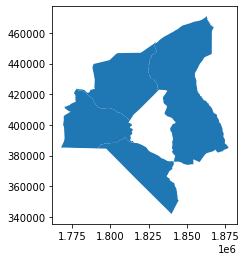

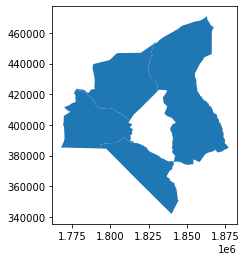

In [61]:
final = geom_validate[0]
join2 = geom_validate[1]

final_false = final[final['GEOM_EQUALS']==False].copy()
join2_false = join2[join2['GEOM_EQUALS']==False].copy()


final_false.plot()


join2_false.plot()